# **STOCK MARKET CLUSTERING**

In this project we will be extracting live Stock Market data from yahoo finance. We will find similarities amongst various companies using their stock stock market prices and then cluster them into different clusters using the K-means algorithm.

Note that this is an unsuppervised machine learning problem and will use an unsuppervised machine learning technique with the help of the K-means algorithm.

NB: "pandas_datareader" extract data from variouse internet sources into a Dataframe. Curently the following sources are supported


*   Yahoo! Finance
*   Google Finance
*  St. Louis FED (FRED)
* Kenneth French's data library
* World Bank
* Google Analytics



In [2]:
# !pip install pandas_datareader

In [3]:
# !pip install plotly

In [6]:
from pandas_datareader import data 
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import datetime
import numpy as np
import plotly.graph_objects as go

In [7]:
companies_dict = {'Terra':'LUNA1-USD','Avalanche':'AVAX-USD','Wrapped Bitcoin':'WBTC-USD','Chainlink':'LINK-USD',
    'Uniswap':'UNI1-USD','Fantom':'FTM-USD','Tezos':'XTZ-USD','Aave':'AAVE-USD','Maker':'MKR-USD','The Graph':'GRT1-USD',
    'Pancake Swap':'CAKE-USD','ThorChain':'RUNE-USD','Curve DAO':'CRV-USD','Convex Finance':'CVX-USD','Basic Attention':'BAT-USD',
    'Loopring':'LRC-USD','Oasis Network':'ROSE-USD','Yearn Finance':'YFI-USD','Compound':'COMP1-USD','Secret':'SCRT-USD',
    '1inch Network':'1INCH-USD','Synthetic':'SNX-USD','renBTC':'RENBTC-USD','Gnosis':'GNO-USD','Sushi Swap':'SUSHI-USD',
    'Kava':'KAVA-USD','0x':'ZRX-USD','Perpetual Protocol':'PERP-USD','Nervos Network':'CKB-USD','Bakery Token':'BAKE-USD',
    'API3':'API3-USD','Neutrino USD':'USDN-USD','Fei USD':'FEI-USD','UMA USD':'UMA-USD','Ocean Protocol':'OCEAN-USD',
    'Chromia':'CHR-USD','Serum':'SRM-USD','Frax Share':'FXS-USD','Raydium':'RAY-USD',
    'Keep Network':'KEEP-USD','Swipe':'SXP-USD','COTI':'COTI-USD','Rari Governance':'RGT-USD','Request':'REQ-USD',
    'Reserve Right':'RSR-USD','Mobox':'MBOX-USD','Frax':'FRAX-USD','DefiChain':'DFI-USD','Liquity USD':'LQTY-USD',
    'NXM':'NXM-USD','AnySwap':'ANY-USD','Rocket Pool':'RPL-USD','Origin Protocol':'OGN-USD','Band Protocol':'BAND-USD',
    'Telos':'TLOS-USD','Origin Dollar':'OUSD-USD','Injective Protocol':'INJ-USD','Mdex':'MDX1-USD','Reef':'REEF-USD',
    'Alchemix':'ALCX-USD','Alpha Finance':'ALPHA-USD','Keep3rV1':'KP3R-USD','iExec RLC':'RLC-USD','Augur':'REP-USD',
    'Numeraire':'NMR-USD','inSure DeFi':'SURE-USD','Orion Protocol':'ORN-USD','Chrono.tech':'TIME-USD','Beefy Finance':'BIFI1-USD',
    'Mango':'MANGO-USD','PolkaStarter':'POLS-USD','DAO maker':'DAO-USD',
    'Badger DAO':'BADGER-USD','Strike':'STRK-USD',
    'IDEXUSD':'IDEX-USD','Circuit of Value':'COVAL-USD','DEFI Pulse Index':'DPI-USD','Ellipsis':'EPS1-USD'
}

In [8]:
data_source = 'yahoo' # Source of data is yahoo finance.12/5/2020
start_date = '2021-05-18'# Start date
end_date = '2022-02-5' # End date
defi = data.DataReader(list(companies_dict.values()),data_source,start_date,end_date)

**NOTE:**

If you are using Google Colab, you might get an error like  "***RemoteDataError: No data fetched using 'YahooDailyReader'*** ", in such case, try using jupyter notebook or jupyter lab. 


Also, some companies might be out of public by the time you run this code and as such, no data will be fetched for such companies, try to take them out of the "***companies_dict***" or replace with any other company you wish. You can visit https://finance.yahoo.com/ to search for companies.

In [9]:
df = defi.copy()

In [10]:
df.head()

Attributes  Adj Close                                                 \
Symbols     LUNA1-USD   AVAX-USD      WBTC-USD   LINK-USD   UNI1-USD   
Date                                                                   
2021-05-18  15.704337  36.822159  43099.414062  42.545315  35.072029   
2021-05-19   9.644053  23.383896  37000.042969  26.701960  23.427958   
2021-05-20  10.405727  25.196884  40761.148438  30.781229  26.394573   
2021-05-21   8.265975  21.801769  37303.964844  25.577578  21.901260   
2021-05-22   6.583102  18.851139  37619.234375  23.292158  20.383455   

Attributes                                                         ...  \
Symbols      FTM-USD   XTZ-USD    AAVE-USD      MKR-USD  GRT1-USD  ...   
Date                                                               ...   
2021-05-18  0.680907  5.744699  632.266479  4657.817383  1.225439  ...   
2021-05-19  0.399183  3.618687  418.369324  3510.677002  0.752991  ...   
2021-05-20  0.450809  4.205408  468.812683  3956.245117  0.909873  ...   
2021-05-21  0.352049  3.681662  373.418518  3116.382568  0.851173  ...   
2021-05-22  0.290235  3.433241  334.480682  2767.623535  0.791539  ...   

Attributes    Volume                                                     \
Symbols    BIFI1-USD MANGO-USD   POLS-USD   DAO-USD BADGER-USD STRK-USD   
Date                                                                      
2021-05-18   3342803      1783   66060852   9399998   26701127   711166   
2021-05-19   7101152      5469  164108142  16621195   33565017  1499877   
2021-05-20   8200353      3790   36634986  11619092   30022108  1771469   
2021-05-21   6762532      4986   29473538  11060239   22729461  2203727   
2021-05-22   8016442      4169   17746753   7650269   15589506  1315656   

Attributes                                         
Symbols    IDEX-USD COVAL-USD   DPI-USD  EPS1-USD  
Date                                               
2021-05-18  1673124    123450  14697650  15840771  
2021-05-19  3199968     16232  15806350  22192759  
2021-05-20  2522774      7556  11197335  16573050  
2021-05-21  1437602      5825   9861851  11071676  
2021-05-22   781562      5443   7292275   6231758  

[5 rows x 468 columns]

In [11]:
df.dropna(axis=0,inplace=True)

df.isna().sum()

Attributes  Symbols  
Adj Close   LUNA1-USD    0
            AVAX-USD     0
            WBTC-USD     0
            LINK-USD     0
            UNI1-USD     0
                        ..
Volume      STRK-USD     0
            IDEX-USD     0
            COVAL-USD    0
            DPI-USD      0
            EPS1-USD     0
Length: 468, dtype: int64

In [12]:
df.dropna(axis=1, inplace=True)
df

Attributes  Adj Close                                                 \
Symbols     LUNA1-USD   AVAX-USD      WBTC-USD   LINK-USD   UNI1-USD   
Date                                                                   
2021-05-18  15.704337  36.822159  43099.414062  42.545315  35.072029   
2021-05-19   9.644053  23.383896  37000.042969  26.701960  23.427958   
2021-05-20  10.405727  25.196884  40761.148438  30.781229  26.394573   
2021-05-21   8.265975  21.801769  37303.964844  25.577578  21.901260   
2021-05-22   6.583102  18.851139  37619.234375  23.292158  20.383455   
...               ...        ...           ...        ...        ...   
2022-02-02  47.567959  67.879974  36993.667969  15.819188  10.515515   
2022-02-03  51.031086  68.107719  37016.140625  16.178110  10.369474   
2022-02-04  53.891132  77.311638  41192.445312  17.445440  11.140662   
2022-02-05  55.374805  77.249489  41467.535156  17.802694  11.265752   
2022-02-06  56.102280  78.757263  42249.074219  18.039454  11.646065   

Attributes                                                         ...  \
Symbols      FTM-USD   XTZ-USD    AAVE-USD      MKR-USD  GRT1-USD  ...   
Date                                                               ...   
2021-05-18  0.680907  5.744699  632.266479  4657.817383  1.225439  ...   
2021-05-19  0.399183  3.618687  418.369324  3510.677002  0.752991  ...   
2021-05-20  0.450809  4.205408  468.812683  3956.245117  0.909873  ...   
2021-05-21  0.352049  3.681662  373.418518  3116.382568  0.851173  ...   
2021-05-22  0.290235  3.433241  334.480682  2767.623535  0.791539  ...   
...              ...       ...         ...          ...       ...  ...   
2022-02-02  1.923014  3.740253  151.542068  2143.220459  0.405446  ...   
2022-02-03  1.954557  3.824548  152.285309  2284.122803  0.404888  ...   
2022-02-04  2.122242  4.014410  166.452393  2280.101318  0.439205  ...   
2022-02-05  2.092230  3.937025  166.500336  2257.123779  0.448783  ...   
2022-02-06  2.160984  3.919473  173.480728  2246.919189  0.472766  ...   

Attributes    Volume                                                       \
Symbols    BIFI1-USD MANGO-USD   POLS-USD   DAO-USD BADGER-USD   STRK-USD   
Date                                                                        
2021-05-18   3342803      1783   66060852   9399998   26701127     711166   
2021-05-19   7101152      5469  164108142  16621195   33565017    1499877   
2021-05-20   8200353      3790   36634986  11619092   30022108    1771469   
2021-05-21   6762532      4986   29473538  11060239   22729461    2203727   
2021-05-22   8016442      4169   17746753   7650269   15589506    1315656   
...              ...       ...        ...       ...        ...        ...   
2022-02-02   4417650      1305    6544881   5305423   11750052  594318837   
2022-02-03   3022474      1615   13006042   7740796    8157894  340937917   
2022-02-04   5453252      2447   10732124   9307743    8012891  118729549   
2022-02-05   3987765      2286    9687497   7573465    9758537   75719091   
2022-02-06   3445885      1510    6277144   3369580    7525109   24284271   

Attributes                                           
Symbols      IDEX-USD COVAL-USD   DPI-USD  EPS1-USD  
Date                                                 
2021-05-18    1673124    123450  14697650  15840771  
2021-05-19    3199968     16232  15806350  22192759  
2021-05-20    2522774      7556  11197335  16573050  
2021-05-21    1437602      5825   9861851  11071676  
2021-05-22     781562      5443   7292275   6231758  
...               ...       ...       ...       ...  
2022-02-02  725216850   1363871   2646037  12648318  
2022-02-03  275486123   1540883    359949  13810750  
2022-02-04   94415210   2191617    548491  24932336  
2022-02-05   62388188   9523092    643999  13730971  
2022-02-06   43948648   8078413    594777  11057752  

[265 rows x 468 columns]

In [13]:
df['Open']

Symbols,LUNA1-USD,AVAX-USD,WBTC-USD,LINK-USD,UNI1-USD,FTM-USD,XTZ-USD,AAVE-USD,MKR-USD,GRT1-USD,...,BIFI1-USD,MANGO-USD,POLS-USD,DAO-USD,BADGER-USD,STRK-USD,IDEX-USD,COVAL-USD,DPI-USD,EPS1-USD
Date,,,,,,,,,,,,,,,,,,,,,
2021-05-18,14.951287,33.628712,43593.578125,37.102032,33.246208,0.580095,5.172699,572.218018,4250.517090,1.193968,...,1186.790405,0.629875,2.987563,4.696516,24.532089,41.565346,0.085471,0.010795,544.108337,1.564695
2021-05-19,15.684366,36.976425,43071.816406,42.637829,35.071213,0.683571,5.745758,629.231689,4657.295410,1.226397,...,1216.428467,0.460313,3.375809,4.769812,25.096029,41.377563,0.087241,0.012841,600.031921,1.515028
2021-05-20,9.514482,23.133921,36918.589844,26.327194,23.162842,0.394932,3.614966,412.876831,3480.934326,0.745803,...,885.404053,0.450727,2.176915,3.914117,16.289213,28.970385,0.052856,0.009052,407.689240,0.952568
2021-05-21,10.369818,25.104174,40785.933594,30.683167,26.355511,0.448668,4.188624,467.526367,3942.360596,0.906755,...,834.983948,0.330611,2.485776,3.987037,18.284460,38.626106,0.058326,0.011409,452.891693,1.029911
2021-05-22,8.280923,21.866186,37339.589844,25.604004,21.964592,0.352522,3.677511,373.803009,3118.791504,0.854226,...,748.200745,0.220415,2.177954,3.377646,15.057637,47.544060,0.048026,0.009886,374.107391,0.850602
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-02-02,52.040424,73.432404,38764.179688,17.022890,11.123271,2.072130,3.754578,163.944214,2198.497314,0.439661,...,2178.299561,0.002995,1.605836,2.332581,11.285688,28.123917,0.168121,0.062419,194.710648,0.168722
2022-02-03,47.550354,67.860443,36994.425781,15.812665,10.515221,1.922694,3.739725,151.518463,2142.506348,0.405274,...,2144.865234,0.002302,1.504594,2.180445,10.184296,44.988503,0.267950,0.058072,184.542694,0.161144
2022-02-04,50.945385,68.108429,37020.703125,16.176838,10.362531,1.954602,3.824141,152.284698,2284.067139,0.404935,...,2245.530029,0.003103,1.588798,2.160553,10.515393,40.751282,0.213847,0.058673,179.999557,0.170398


In [14]:
df['Close']

Symbols,LUNA1-USD,AVAX-USD,WBTC-USD,LINK-USD,UNI1-USD,FTM-USD,XTZ-USD,AAVE-USD,MKR-USD,GRT1-USD,...,BIFI1-USD,MANGO-USD,POLS-USD,DAO-USD,BADGER-USD,STRK-USD,IDEX-USD,COVAL-USD,DPI-USD,EPS1-USD
Date,,,,,,,,,,,,,,,,,,,,,
2021-05-18,15.704337,36.822159,43099.414062,42.545315,35.072029,0.680907,5.744699,632.266479,4657.817383,1.225439,...,1216.768921,0.460287,3.395223,4.774078,25.018227,41.400497,0.087304,0.012841,600.252686,1.514952
2021-05-19,9.644053,23.383896,37000.042969,26.701960,23.427958,0.399183,3.618687,418.369324,3510.677002,0.752991,...,887.128845,0.450738,2.205564,3.917270,16.345703,29.058706,0.053163,0.009054,407.999451,0.960592
2021-05-20,10.405727,25.196884,40761.148438,30.781229,26.394573,0.450809,4.205408,468.812683,3956.245117,0.909873,...,824.912964,0.330594,2.492235,3.991344,18.263681,38.606503,0.058477,0.011415,453.967438,1.030831
2021-05-21,8.265975,21.801769,37303.964844,25.577578,21.901260,0.352049,3.681662,373.418518,3116.382568,0.851173,...,747.235352,0.220412,2.177942,3.371651,15.107423,47.584553,0.048020,0.009883,373.485138,0.850593
2021-05-22,6.583102,18.851139,37619.234375,23.292158,20.383455,0.290235,3.433241,334.480682,2767.623535,0.791539,...,719.218018,0.280436,1.891055,3.119427,13.765536,44.878185,0.048198,0.007736,340.552795,0.772204
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-02-02,47.567959,67.879974,36993.667969,15.819188,10.515515,1.923014,3.740253,151.542068,2143.220459,0.405446,...,2144.376465,0.002302,1.504798,2.180473,10.186191,45.034286,0.268676,0.058055,184.542801,0.161160
2022-02-03,51.031086,68.107719,37016.140625,16.178110,10.369474,1.954557,3.824548,152.285309,2284.122803,0.404888,...,2245.286377,0.003103,1.588965,2.156832,10.510992,40.628983,0.213474,0.058726,179.998917,0.170389
2022-02-04,53.891132,77.311638,41192.445312,17.445440,11.140662,2.122242,4.014410,166.452393,2280.101318,0.439205,...,2271.293457,0.003798,1.805353,2.280151,11.399212,40.946175,0.199926,0.061456,193.726303,0.188055


In [15]:
stock_open = np.array(df['Open']).T # stock_open is numpy array of transpose of df['Open']
stock_close = np.array(df['Close']).T # stock_close is numpy array of transpose of df['Close']

#‘movement’ is the difference of opening and closing prices of a particular day. Positive movement suggests to go long on stock(buy) and negative movement suggests to short the stock(sell).
movements = stock_close - stock_open

In [16]:
movements

array([[ 7.53049850e-01, -6.04031277e+00,  8.91245842e-01, ...,
         2.94574738e+00,  1.45576859e+00,  7.04822540e-01],
       [ 3.19344711e+00, -1.35925293e+01,  2.06296349e+00, ...,
         9.20320892e+00, -2.15522766e-01,  1.51526642e+00],
       [-4.94164062e+02, -6.07177344e+03,  3.84255859e+03, ...,
         4.17174219e+03,  2.72679688e+02,  7.82117188e+02],
       ...,
       [ 2.04600021e-03, -3.78700066e-03,  2.36300007e-03, ...,
         2.78299674e-03,  6.68099895e-03, -9.87999141e-04],
       [ 5.61443481e+01, -1.92032471e+02,  4.62781982e+01, ...,
         1.37267456e+01,  3.31771851e+00,  5.68237305e+00],
       [-4.97430563e-02, -5.54436028e-01,  7.82629848e-02, ...,
         1.76569968e-02, -3.32899392e-03,  2.81199813e-03]])

In [346]:
#####################  SAVING BOTH THE QUERIED RAW DATASET AND CLEANED DATASET TO DEVICE  #######################################
# defi.to_csv('DEFI5_raw.csv') # for more understanding of the data we save the data into a csv and view in excel spreadsheet
# df.to_csv('DEFI5.csv')

In [17]:
sum_of_movement = sum(stock_close - stock_open)

In [18]:
keys = list(companies_dict.keys())
values = list(companies_dict.values())

frame1 = []
for (key, i) in zip(keys,range(len(df['High'].columns))):
    frame1.append(['{}'.format(key),'{}'.format(sum_of_movement[i])])
# print(frame1)
frame2 = pd.DataFrame(frame1,columns=['Company','Change'])
frame2

,Company,Change
0,Terra,8432.039332259912
1,Avalanche,-42054.916174236685
2,Wrapped Bitcoin,14440.72796124313
3,Chainlink,-16577.437159532914
4,Uniswap,-5336.202321177814
...,...,...
73,Strike,4210.157508872217
74,IDEXUSD,1570.8308465154842
75,Circuit of Value,-4508.6030760922
76,DEFI Pulse Index,-1332.325057924958


In [433]:
frame2.to_csv('sum_of_movement.csv', index=False) #saving the dataframe to device

In [434]:
# for i in range(len(df['High'].columns)):
#     print('company:{}, Change:{}'.format(df['High'].columns[i],sum_of_movement[i]))


## EDA

In [19]:

def chart(C=str(),x=str(),y=str()):
    """
    A function that enables us plot the individual line charts
    C = the title of the chart which
    x = x-axis plot
    y = y-axis plot
    """

    plt.title('Company:{}'.format(C),fontsize = 20)
    plt.xticks(fontsize = 10)
    plt.yticks(fontsize = 20)
    plt.xlabel('Date',fontsize = 15,)
    plt.xticks(rotation=45)
    plt.ylabel('Opening price',fontsize = 15)
    return(plt.plot(df[x][y]))

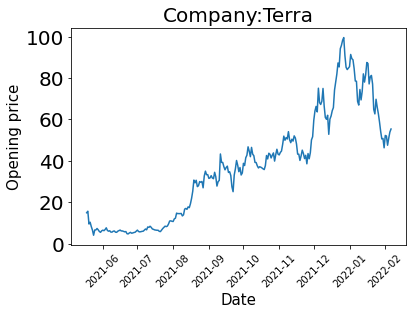

In [20]:
# 'Terra':'LUNA1-USD'
chart('Terra','Open', 'LUNA1-USD')

In [356]:

############  CREATING A FLATTENED DATAFRAME #################

keys = list(companies_dict.keys())
values = list(companies_dict.values())

df2 = pd.DataFrame()

for value in values:
    df2[value] = df['Open'][value]
#     print(df2)


df_open = pd.DataFrame(df2.to_records()) # flattens the record by removing multiindexing format
df_open

,Date,LUNA1-USD,AVAX-USD,WBTC-USD,LINK-USD,UNI1-USD,FTM-USD,XTZ-USD,AAVE-USD,MKR-USD,...,BIFI1-USD,MANGO-USD,POLS-USD,DAO-USD,BADGER-USD,STRK-USD,IDEX-USD,COVAL-USD,DPI-USD,EPS1-USD
0,2021-05-18,14.951287,33.628712,43593.578125,37.102032,33.246208,0.580095,5.172699,572.218018,4250.517090,...,1186.790405,0.629875,2.987563,4.696516,24.532089,41.565346,0.085471,0.010795,544.108337,1.564695
1,2021-05-19,15.684366,36.976425,43071.816406,42.637829,35.071213,0.683571,5.745758,629.231689,4657.295410,...,1216.428467,0.460313,3.375809,4.769812,25.096029,41.377563,0.087241,0.012841,600.031921,1.515028
2,2021-05-20,9.514482,23.133921,36918.589844,26.327194,23.162842,0.394932,3.614966,412.876831,3480.934326,...,885.404053,0.450727,2.176915,3.914117,16.289213,28.970385,0.052856,0.009052,407.689240,0.952568
3,2021-05-21,10.369818,25.104174,40785.933594,30.683167,26.355511,0.448668,4.188624,467.526367,3942.360596,...,834.983948,0.330611,2.485776,3.987037,18.284460,38.626106,0.058326,0.011409,452.891693,1.029911
4,2021-05-22,8.280923,21.866186,37339.589844,25.604004,21.964592,0.352522,3.677511,373.803009,3118.791504,...,748.200745,0.220415,2.177954,3.377646,15.057637,47.544060,0.048026,0.009886,374.107391,0.850602
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
260,2022-02-02,52.040424,73.432404,38764.179688,17.022890,11.123271,2.072130,3.754578,163.944214,2198.497314,...,2178.299561,0.002995,1.605836,2.332581,11.285688,28.123917,0.168121,0.062419,194.710648,0.168722
261,2022-02-03,47.550354,67.860443,36994.425781,15.812665,10.515221,1.922694,3.739725,151.518463,2142.506348,...,2144.865234,0.002302,1.504594,2.180445,10.184296,44.988503,0.267950,0.058072,184.542694,0.161144
262,2022-02-04,50.945385,68.108429,37020.703125,16.176838,10.362531,1.954602,3.824141,152.284698,2284.067139,...,2245.530029,0.003103,1.588798,2.160553,10.515393,40.751282,0.213847,0.058673,179.999557,0.170398
263,2022-02-05,53.919037,77.465012,41194.855469,17.451298,11.147378,2.122355,4.013500,166.475220,2279.755615,...,2271.763184,0.003798,1.805265,2.279899,11.397767,41.012466,0.200043,0.061322,193.725967,0.188052


In [104]:
# df_open.to_csv('df_defi_flatten.csv', index=False)

Text(0.5, 1.0, 'Terra')
Text(0.5, 1.0, 'Avalanche')
Text(0.5, 1.0, 'Wrapped Bitcoin')
Text(0.5, 1.0, 'Chainlink')
Text(0.5, 1.0, 'Uniswap')
Text(0.5, 1.0, 'Fantom')
Text(0.5, 1.0, 'Tezos')
Text(0.5, 1.0, 'Aave')
Text(0.5, 1.0, 'Maker')
Text(0.5, 1.0, 'The Graph')
Text(0.5, 1.0, 'Pancake Swap')
Text(0.5, 1.0, 'ThorChain')
Text(0.5, 1.0, 'Curve DAO')
Text(0.5, 1.0, 'Convex Finance')
Text(0.5, 1.0, 'Basic Attention')
Text(0.5, 1.0, 'Loopring')
Text(0.5, 1.0, 'Oasis Network')
Text(0.5, 1.0, 'Yearn Finance')
Text(0.5, 1.0, 'Compound')
Text(0.5, 1.0, 'Secret')
Text(0.5, 1.0, '1inch Network')
Text(0.5, 1.0, 'Synthetic')
Text(0.5, 1.0, 'renBTC')
Text(0.5, 1.0, 'Gnosis')
Text(0.5, 1.0, 'Sushi Swap')
Text(0.5, 1.0, 'Kava')
Text(0.5, 1.0, '0x')
Text(0.5, 1.0, 'Perpetual Protocol')
Text(0.5, 1.0, 'Nervos Network')
Text(0.5, 1.0, 'Bakery Token')
Text(0.5, 1.0, 'API3')
Text(0.5, 1.0, 'Neutrino USD')
Text(0.5, 1.0, 'Fei USD')
Text(0.5, 1.0, 'UMA USD')
Text(0.5, 1.0, 'Ocean Protocol')
Text(0.5, 1.0, '

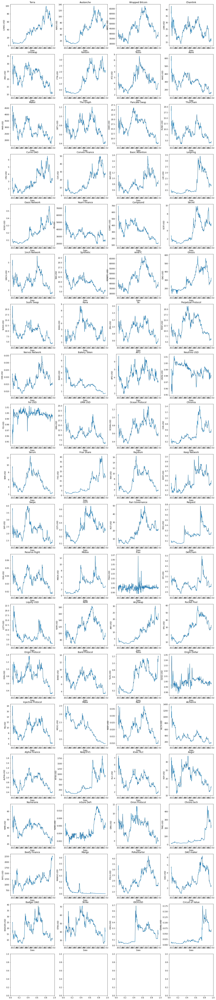

In [357]:
fig, ax2 = plt.subplots(20,4, figsize=(20,100))
i = list(range(0,19))*4
i.sort()
j = [0,1,2,3] * 20
keys = list(companies_dict.keys())
for (a,b,d,c) in zip(i,j,keys,df_open.columns[1:]):
    print(sns.lineplot(data=df_open, x='Date', y=c, ax=ax2[a][b]).set_title(d));

## Focusing on Opening Vs Closing Price Trend

In [408]:
df.shape[0]

265

In [409]:
def open_close_plot(col=str(),title=str(),a=0,b=df.shape[0]):
    """
    functon to create a plot showing opening time trend and closing time trend
    col = column of the dataframe
    title = title of the plot
    a= start point (this takes 0, the first row count of the dataframe as default)
    b= end point (this takes the last row count of the dataframe as default)
    parameter a and b can be changed when using the function
    Example: Getting the plot for the first 50 will be passing a=0 and b=50
    """

    plt.figure(figsize = (20,10)) # Adjusting figure size
    plt.title('Company: {}'.format(title),fontsize = 20)
    plt.xticks(fontsize = 10)
    plt.yticks(fontsize = 20)
    plt.xlabel('Date',fontsize = 20)
    plt.ylabel('Price',fontsize = 20)
    plt.plot(df.iloc[a:b]['Open'][col],label = 'Open') # Opening prices of first 30 days are plotted against date
    plt.plot(df.iloc[a:b]['Close'][col],label = 'Close') # Closing prices of first 30 days are plotted against date
    plt.legend(loc='upper left', frameon=False,framealpha=1,prop={'size': 22}) # Properties of legend box
    plt.show()

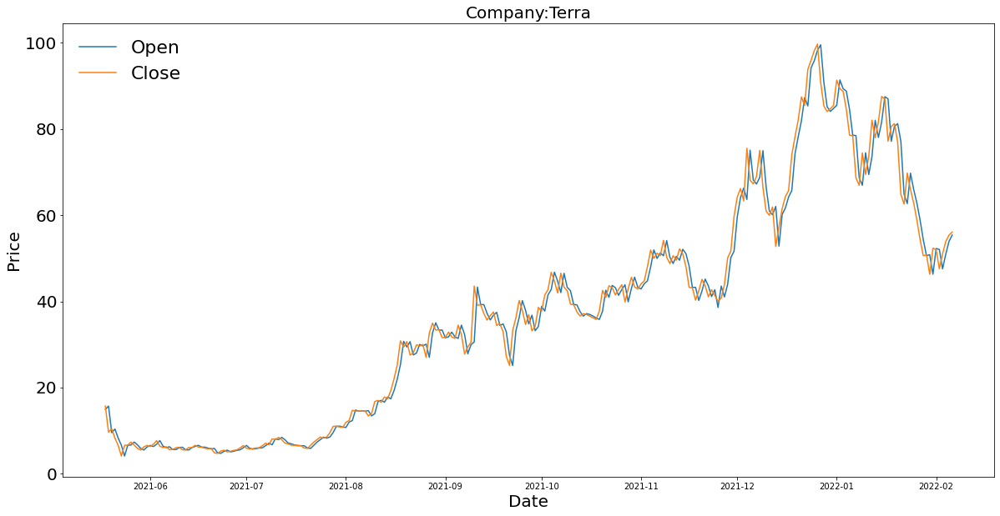

None


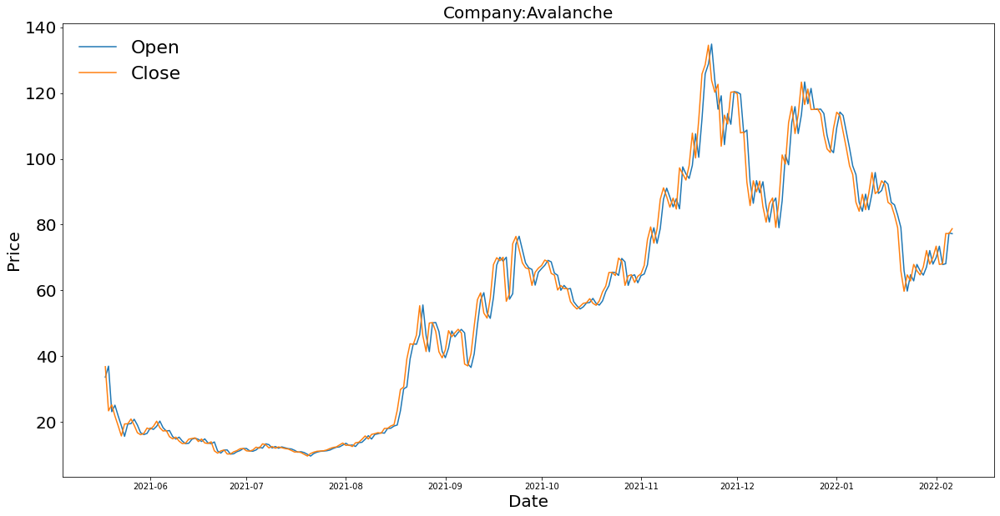

None


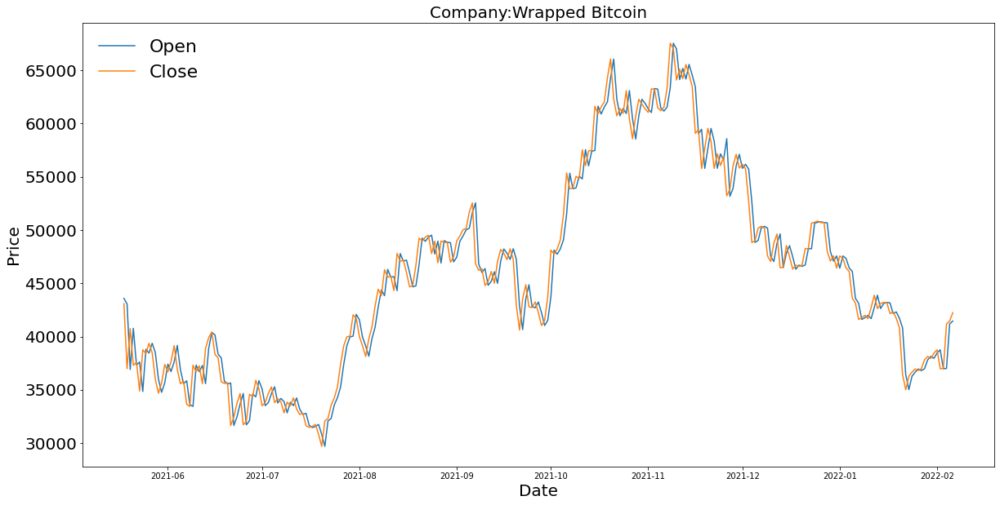

None


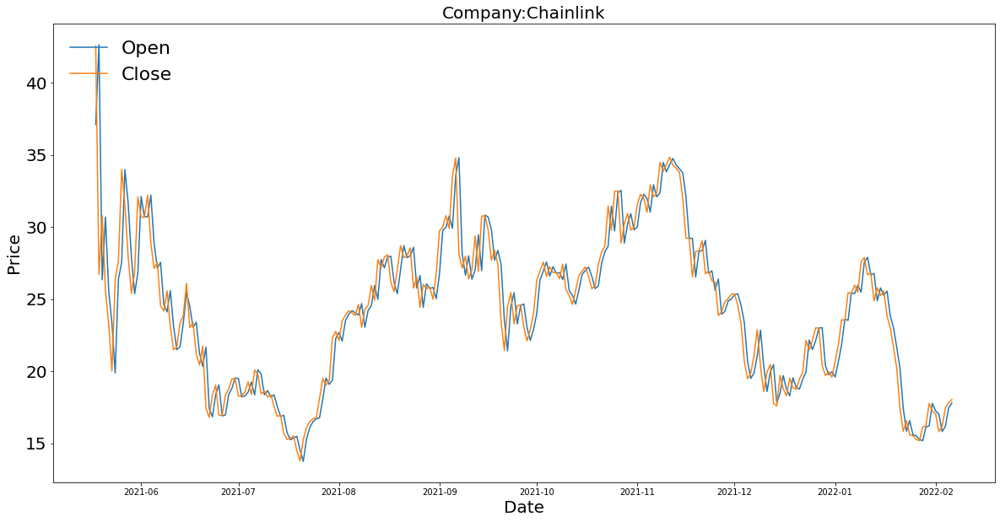

None


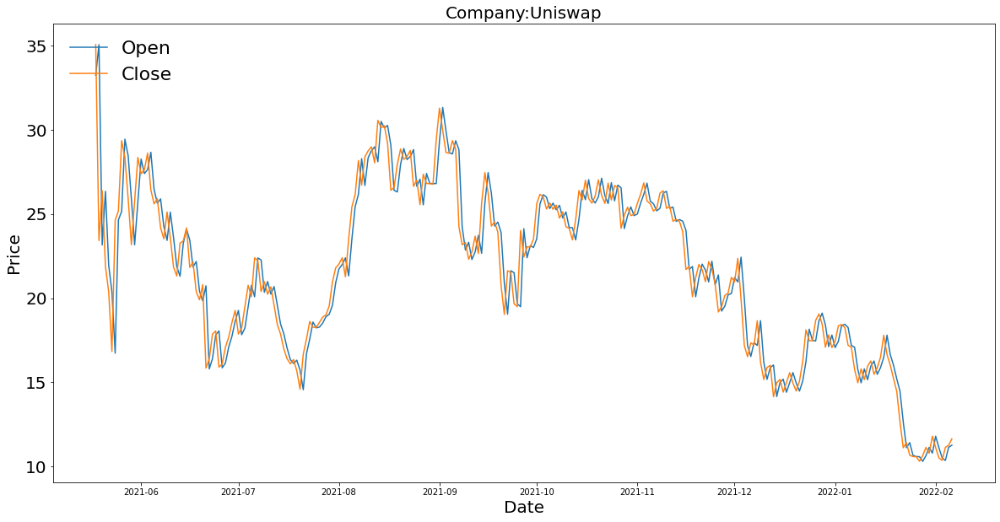

None


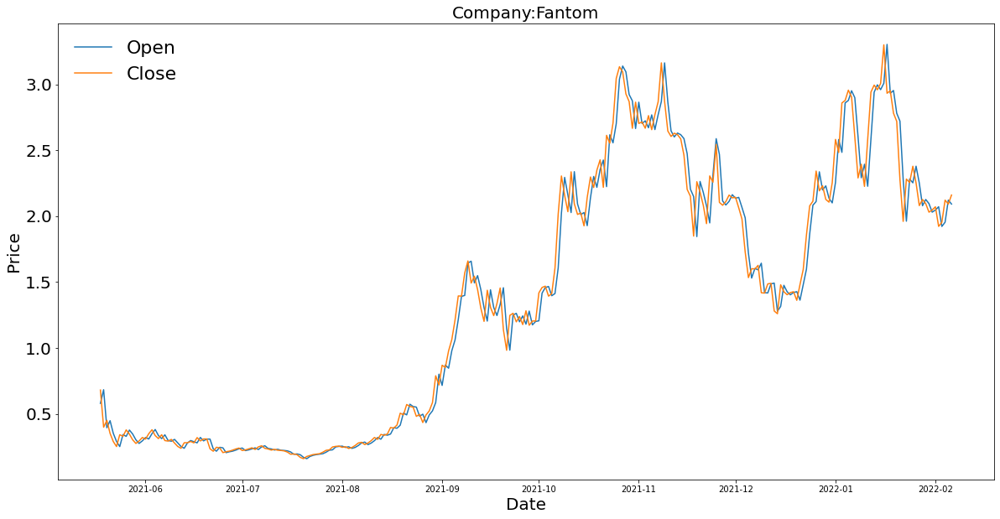

None


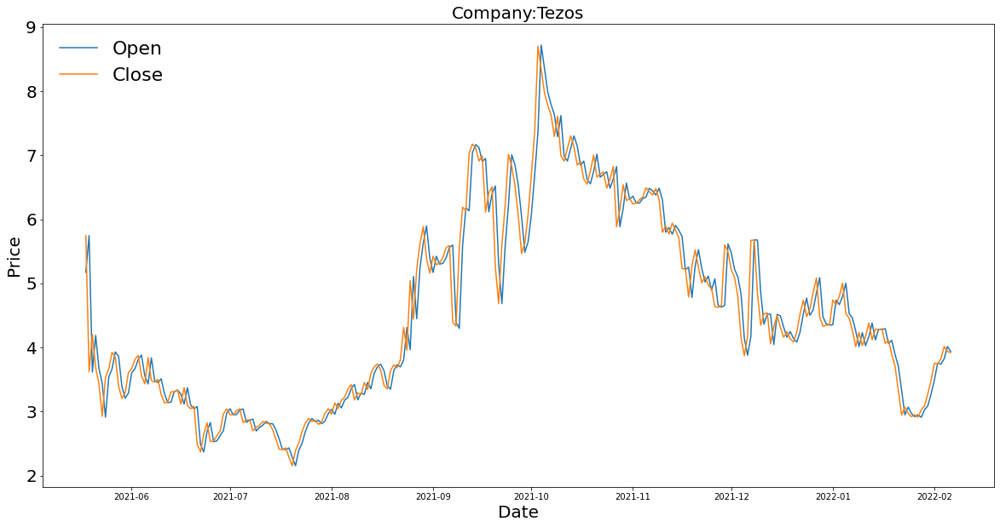

None


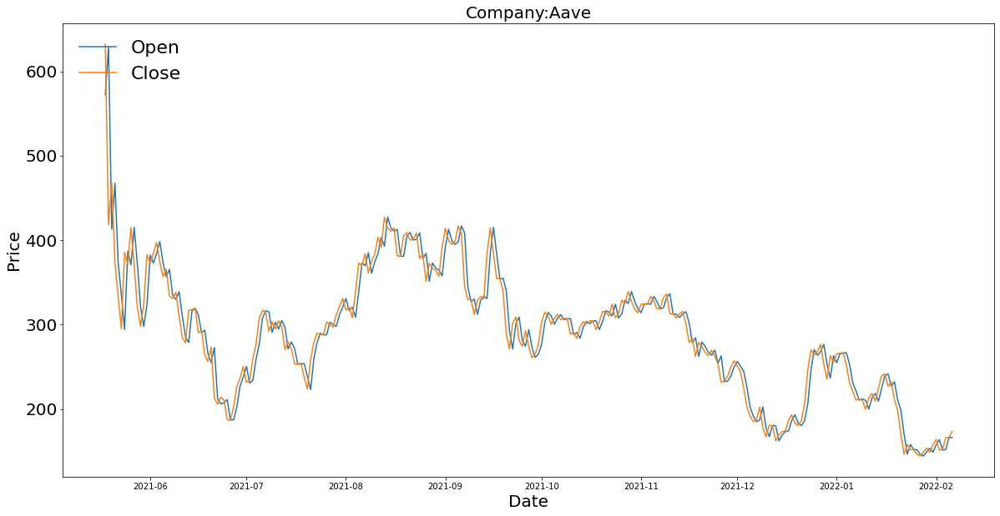

None


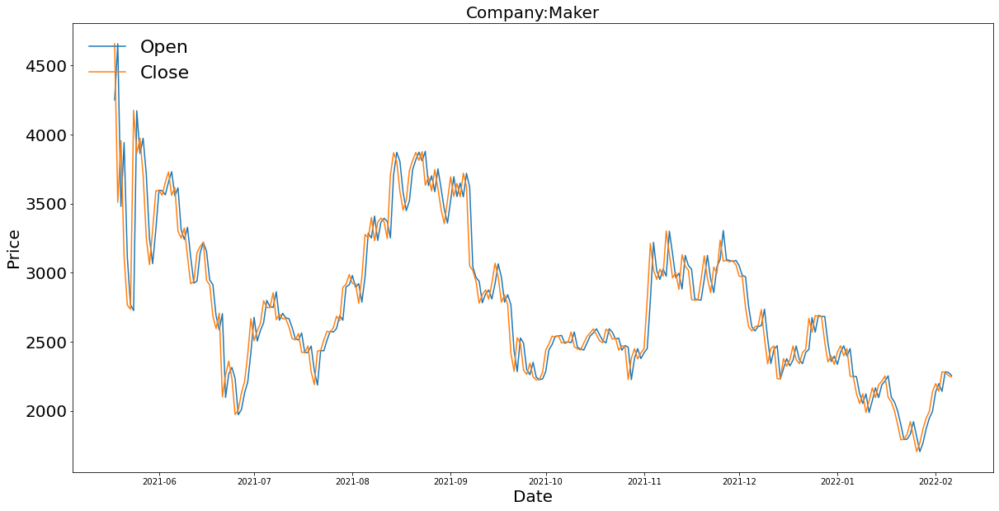

None


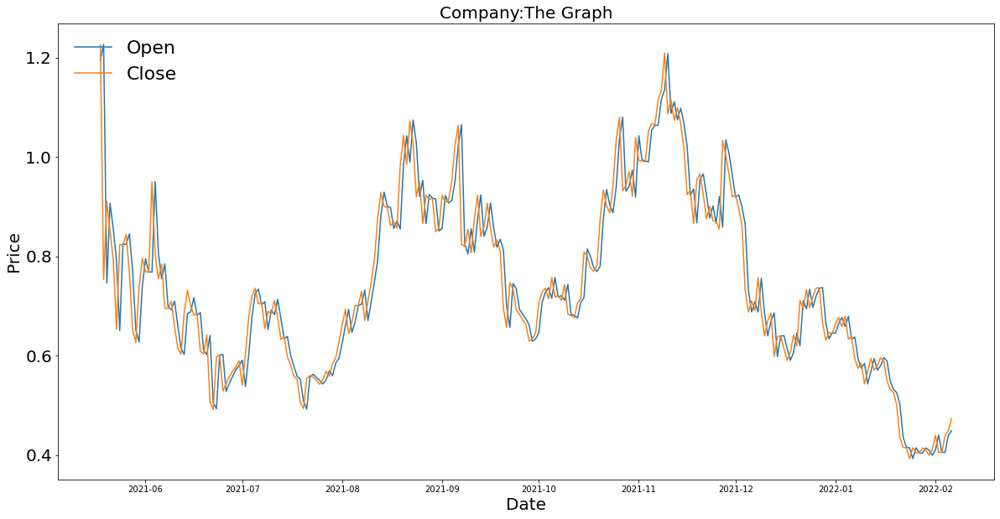

None


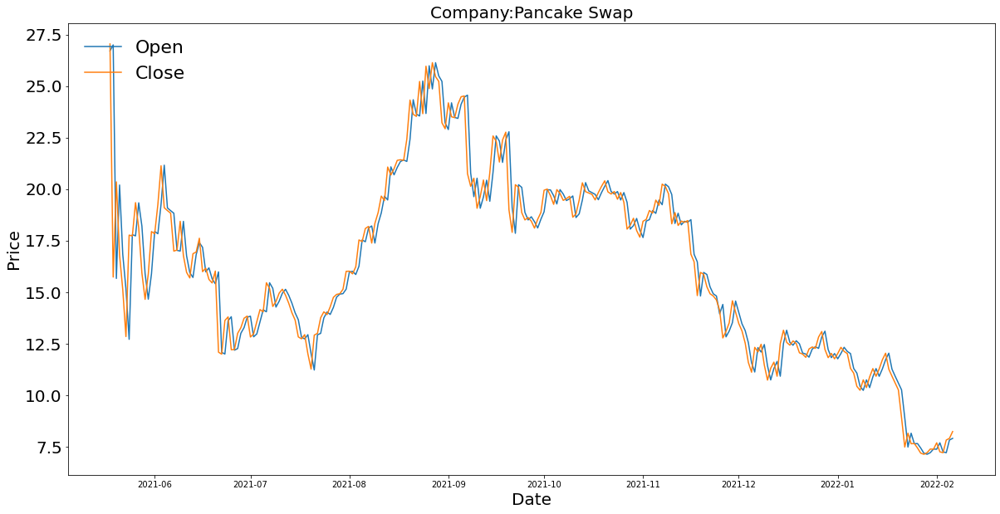

None


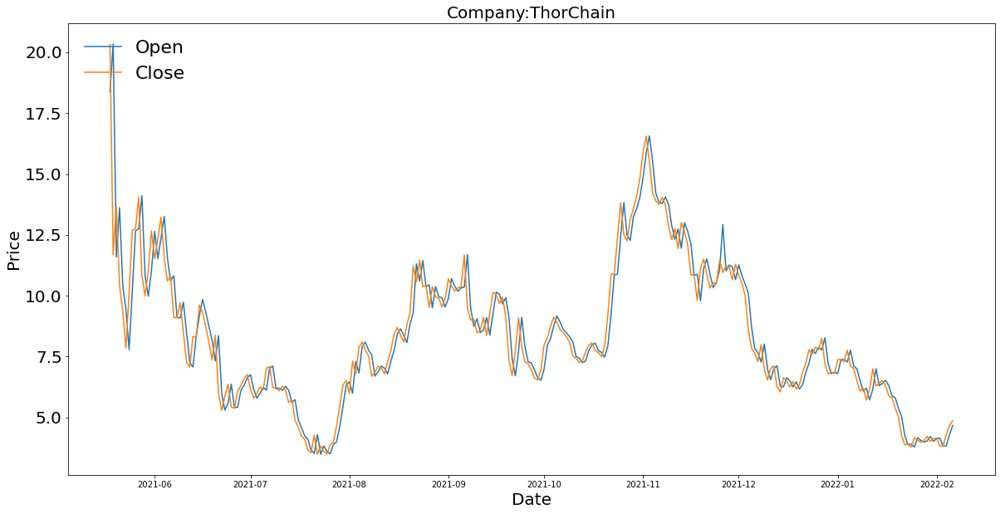

None


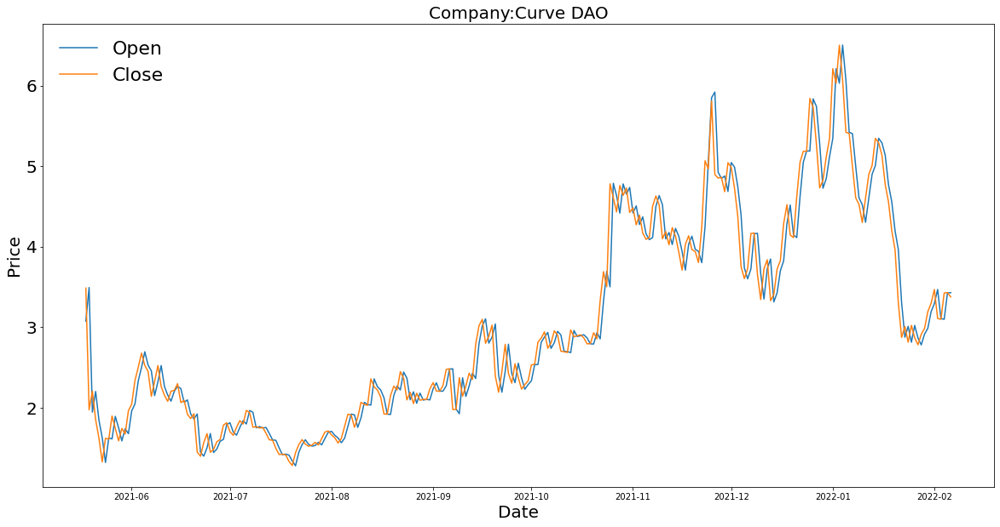

None


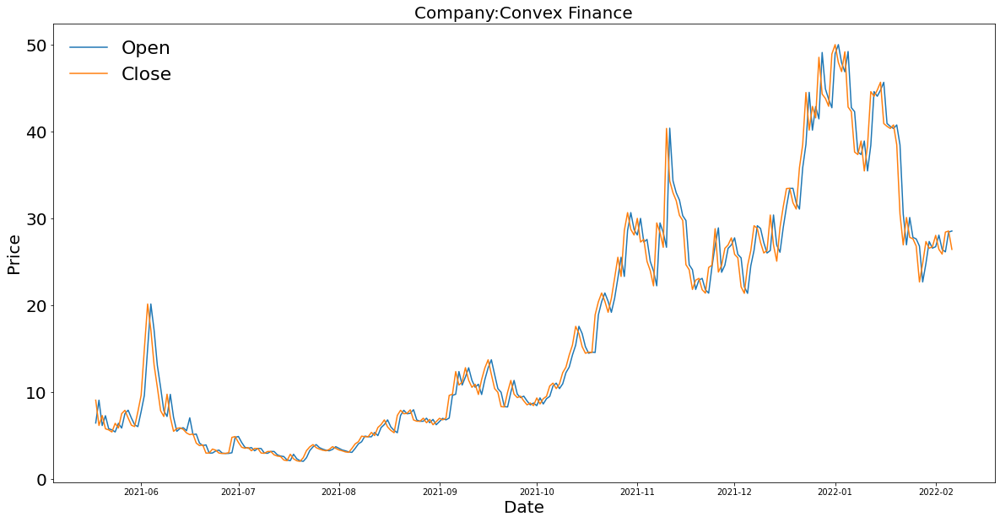

None


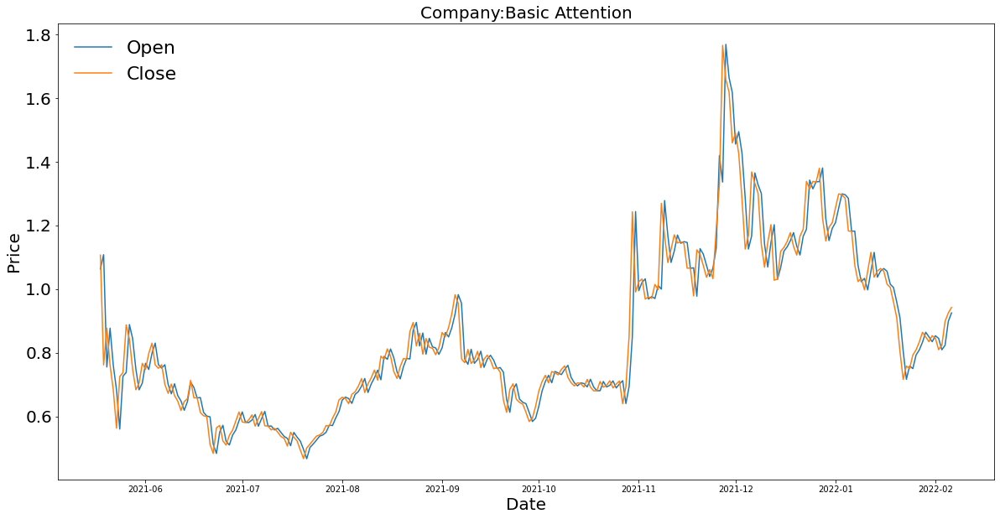

None


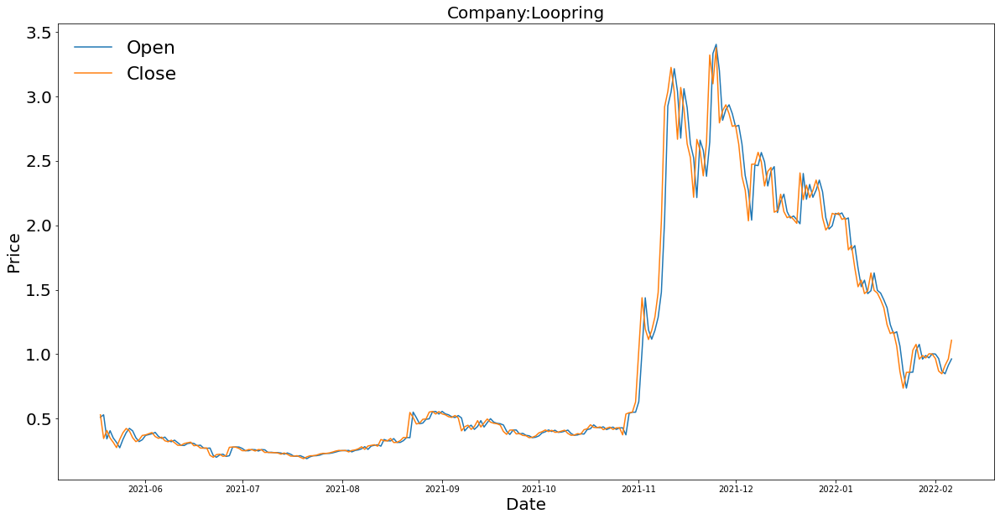

None


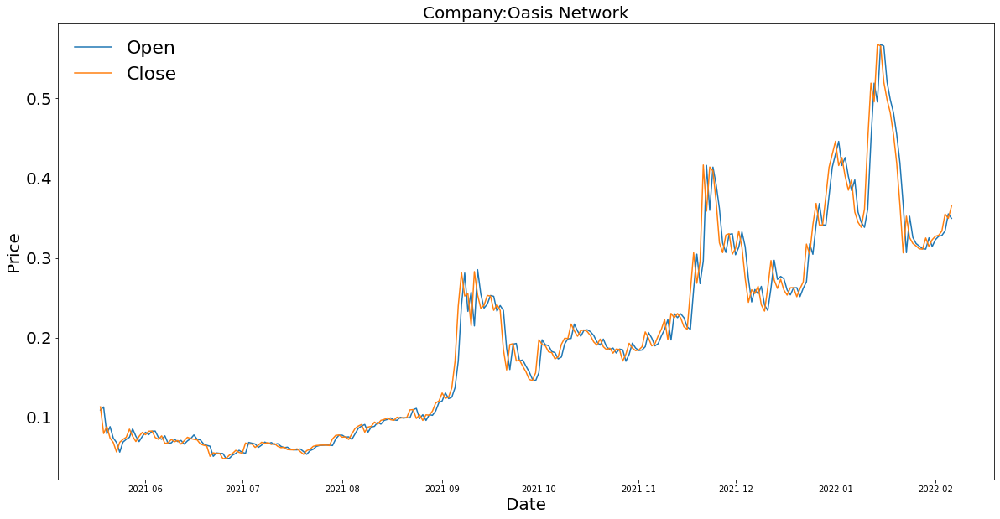

None


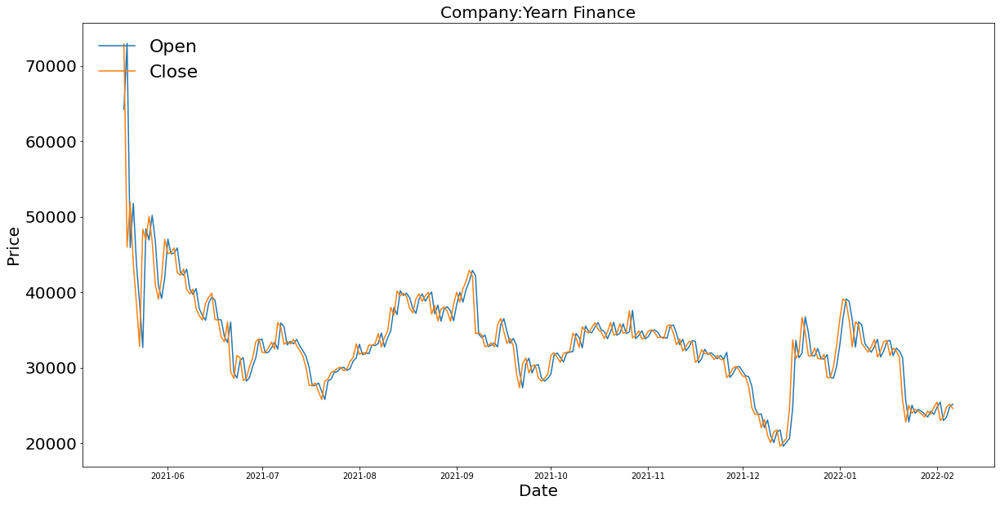

None


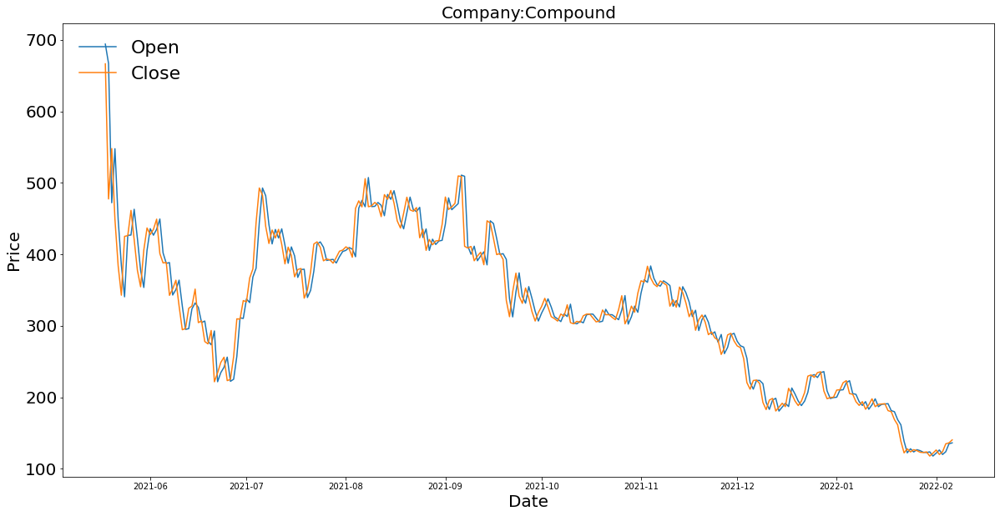

None


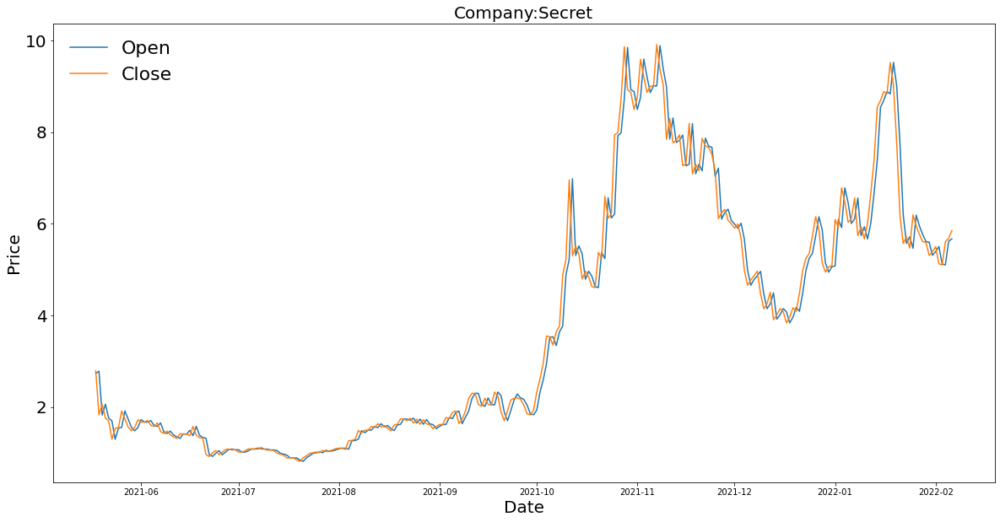

None


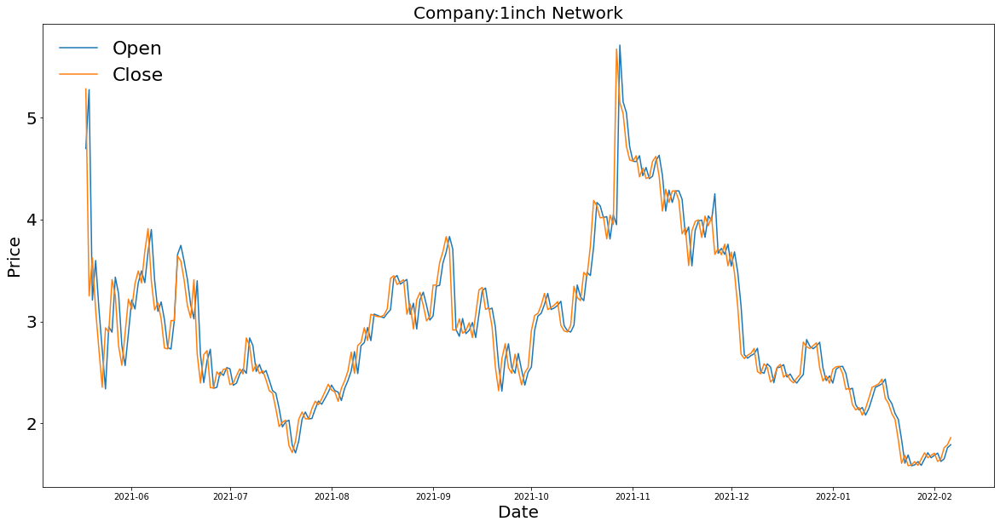

None


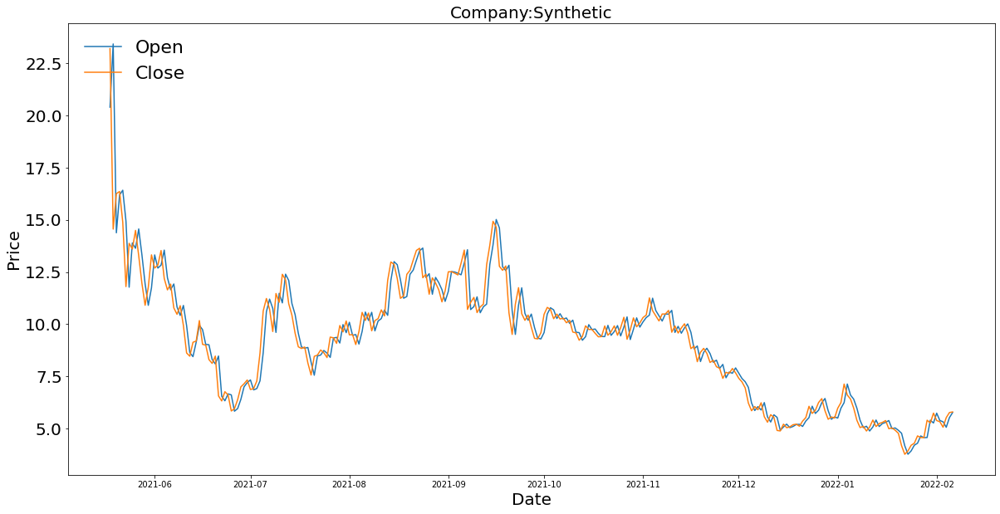

None


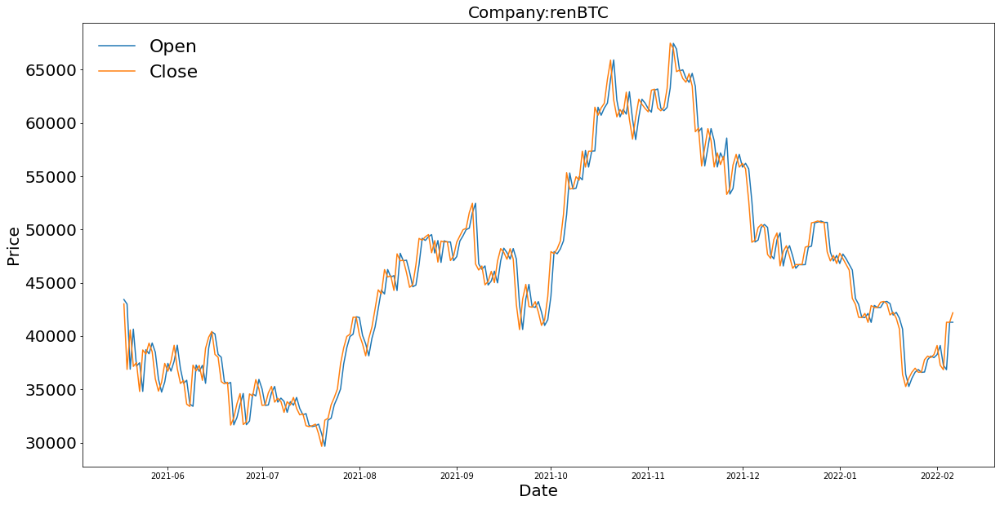

None


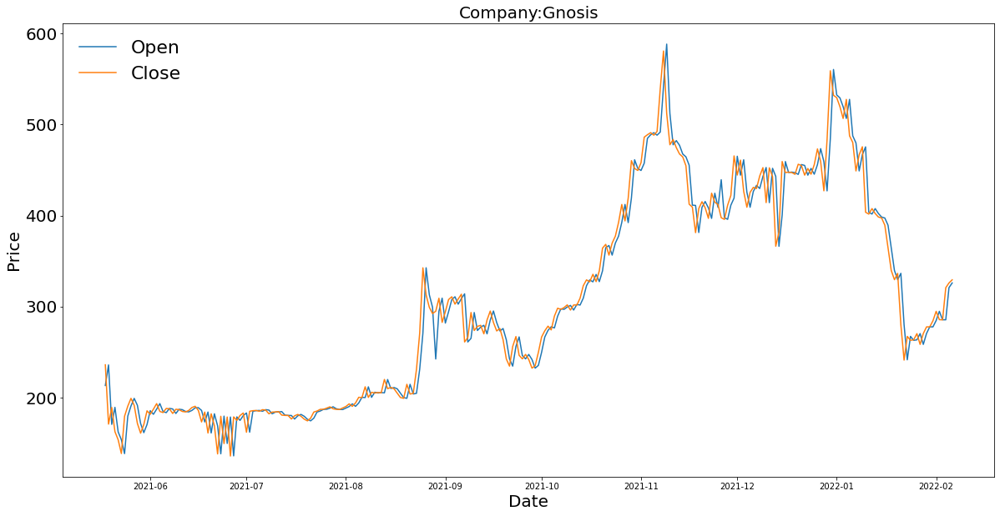

None


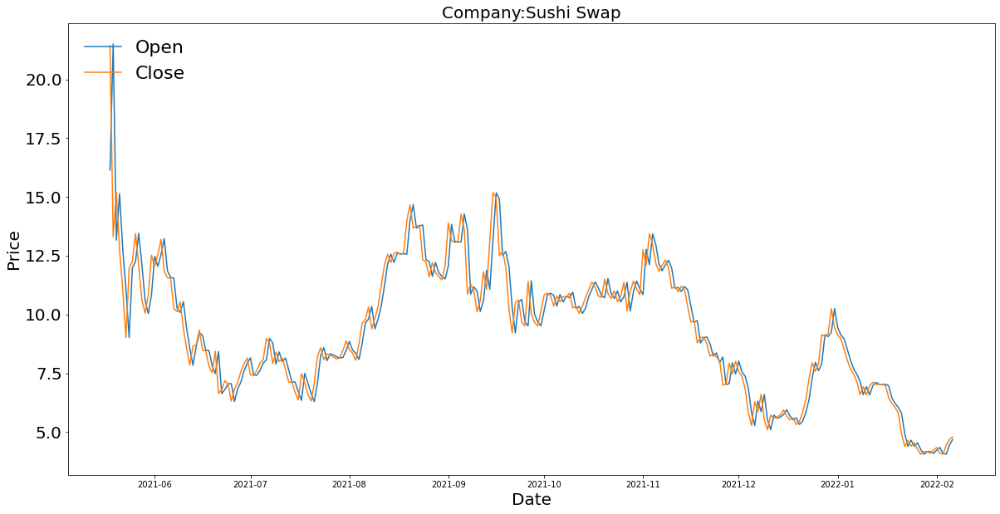

None


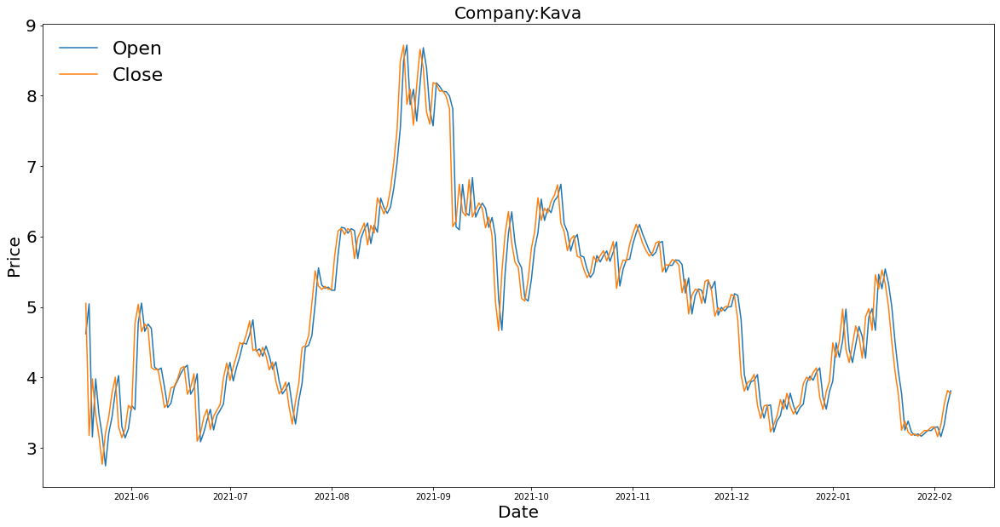

None


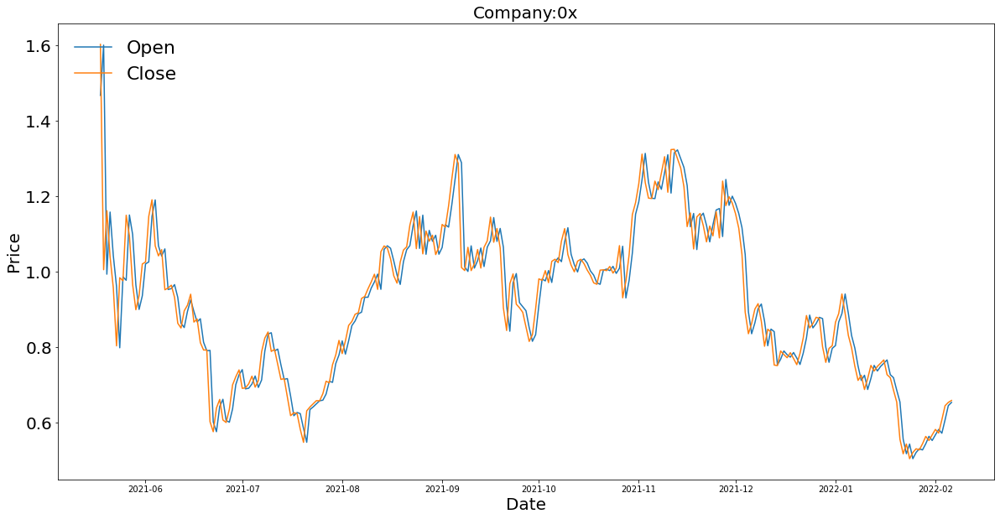

None


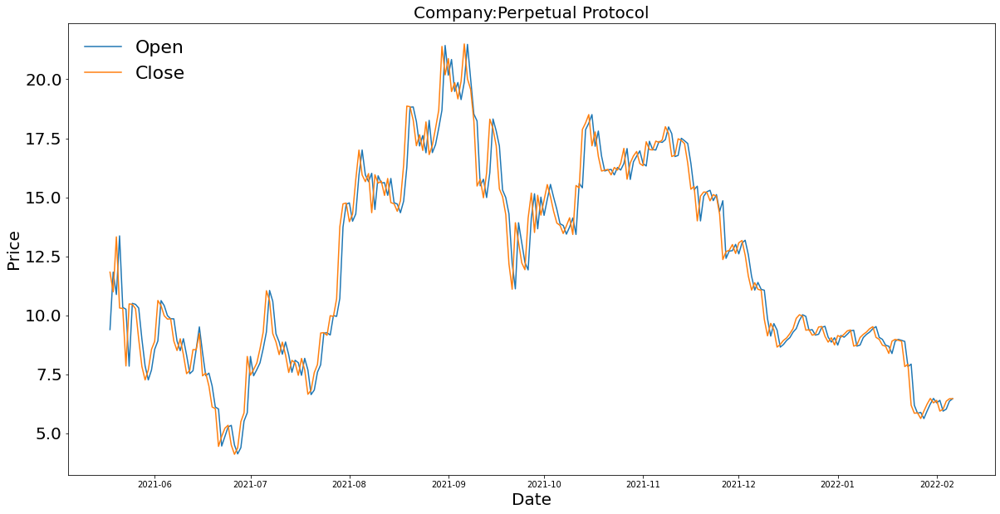

None


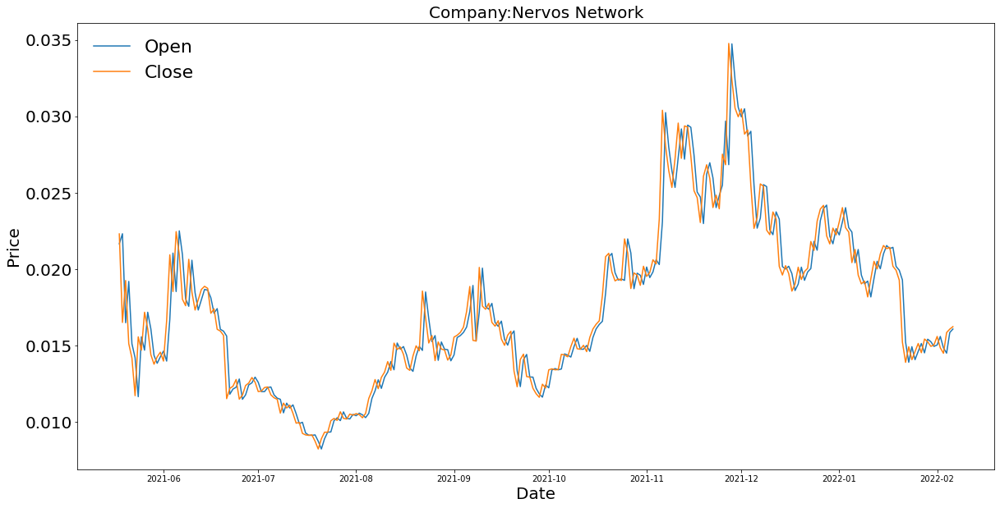

None


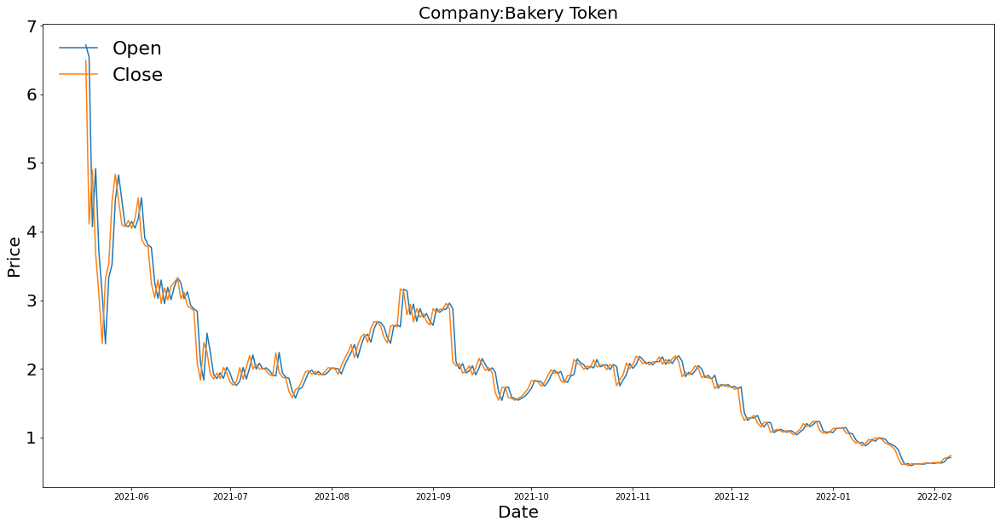

None


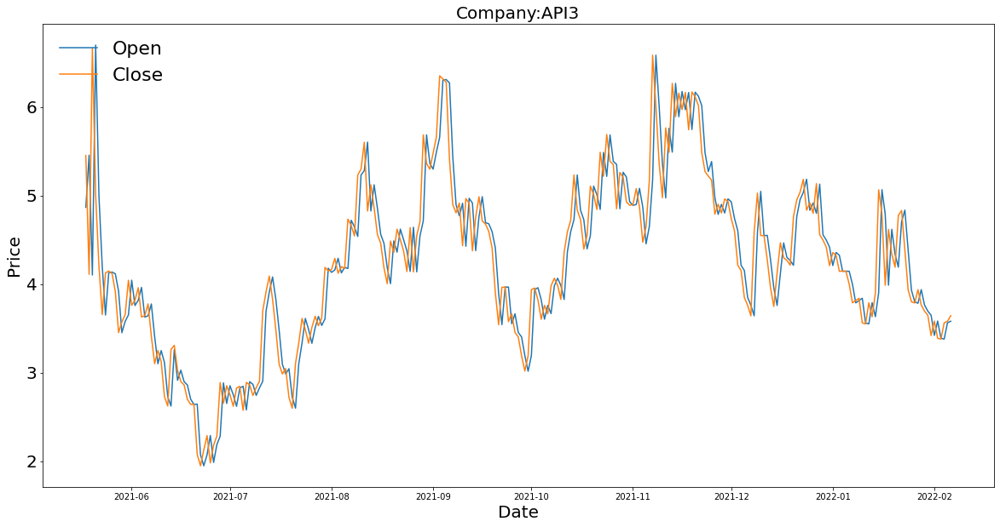

None


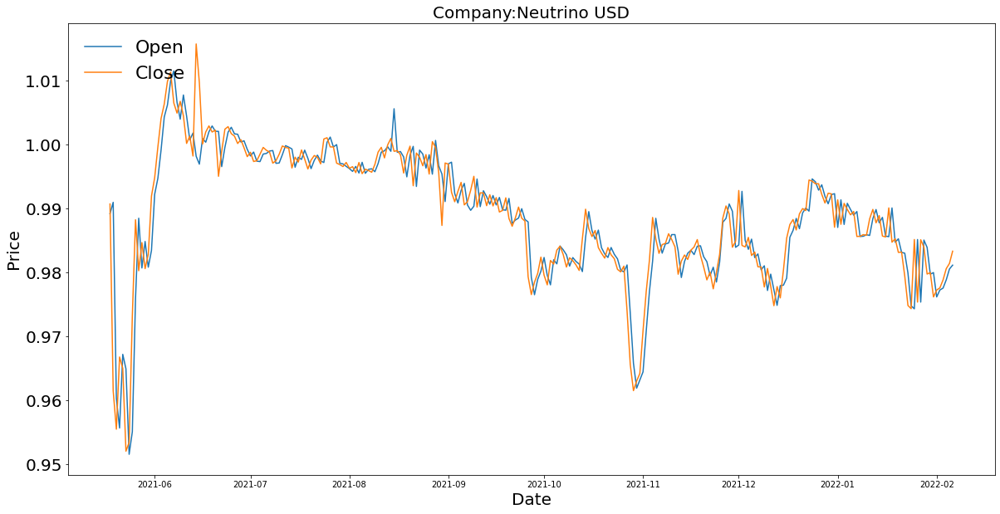

None


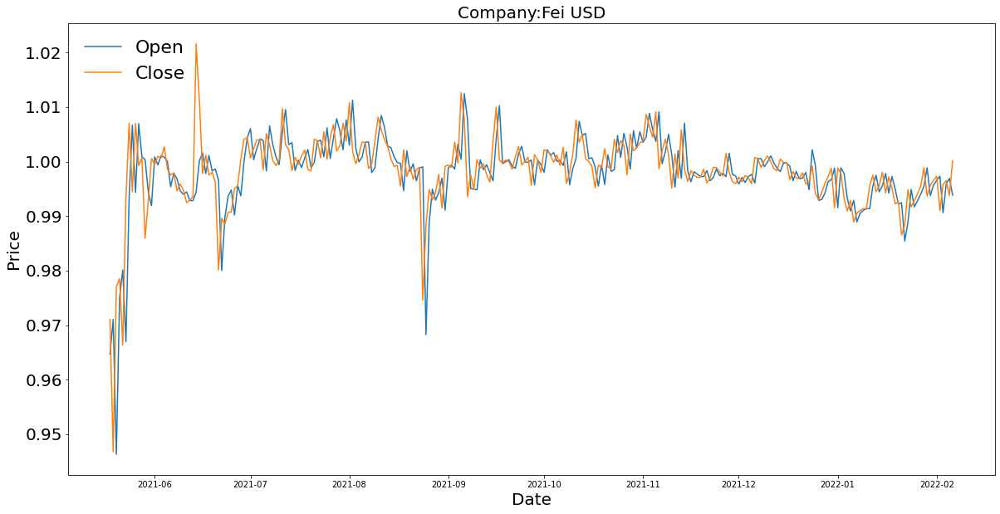

None


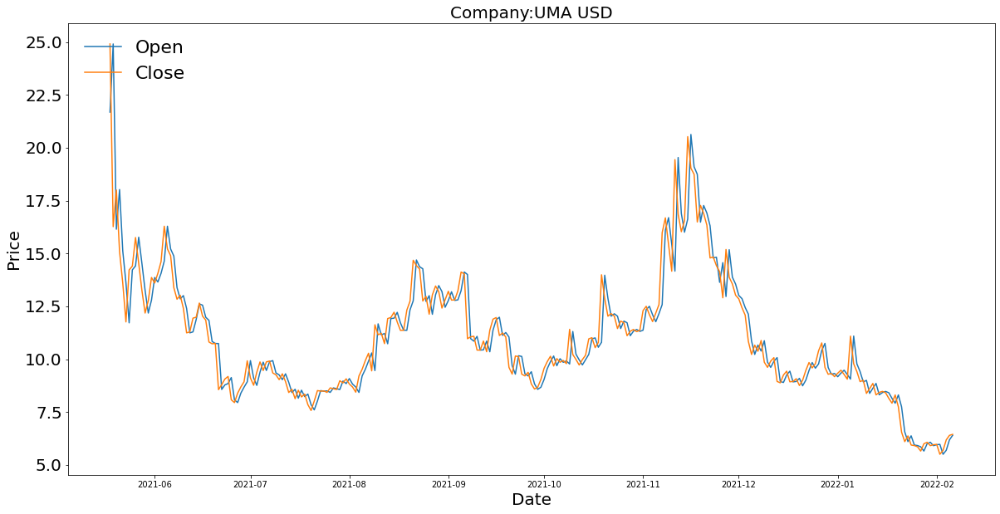

None


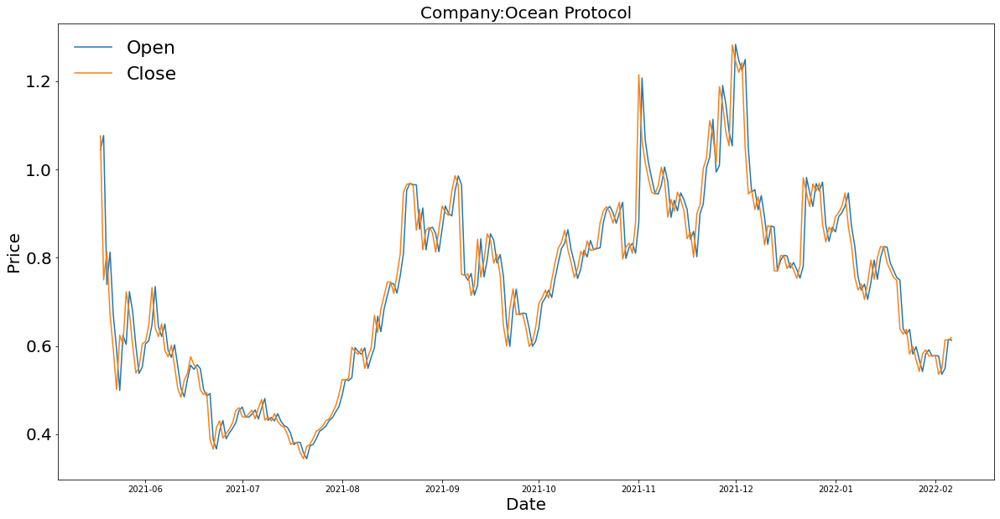

None


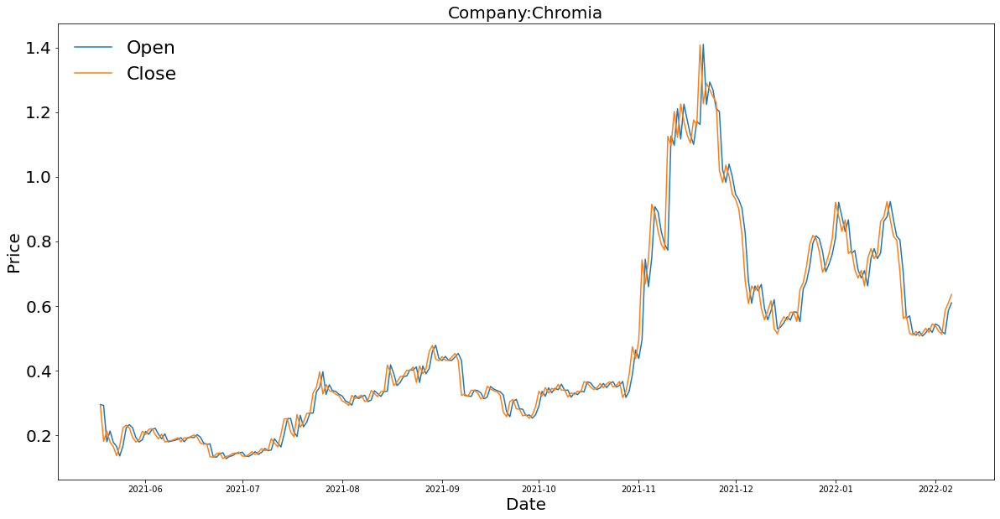

None


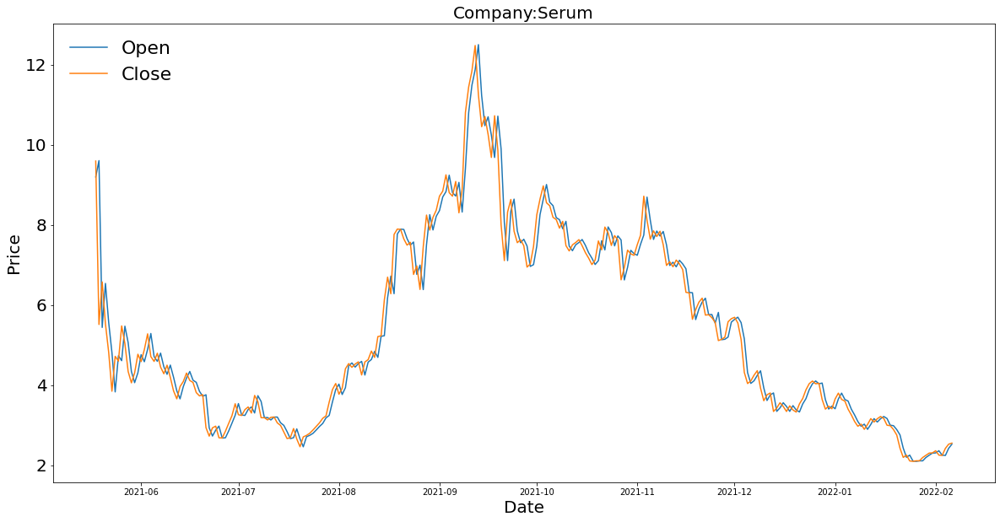

None


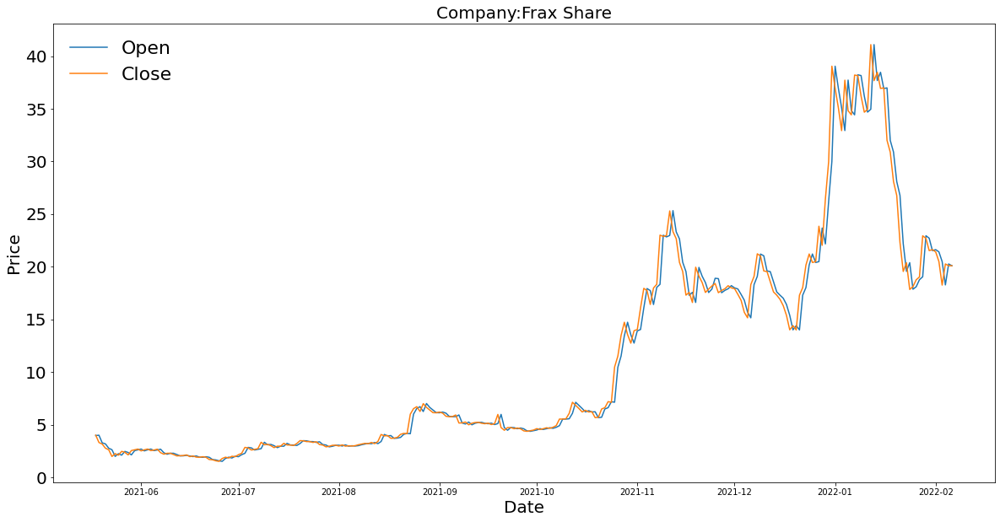

None


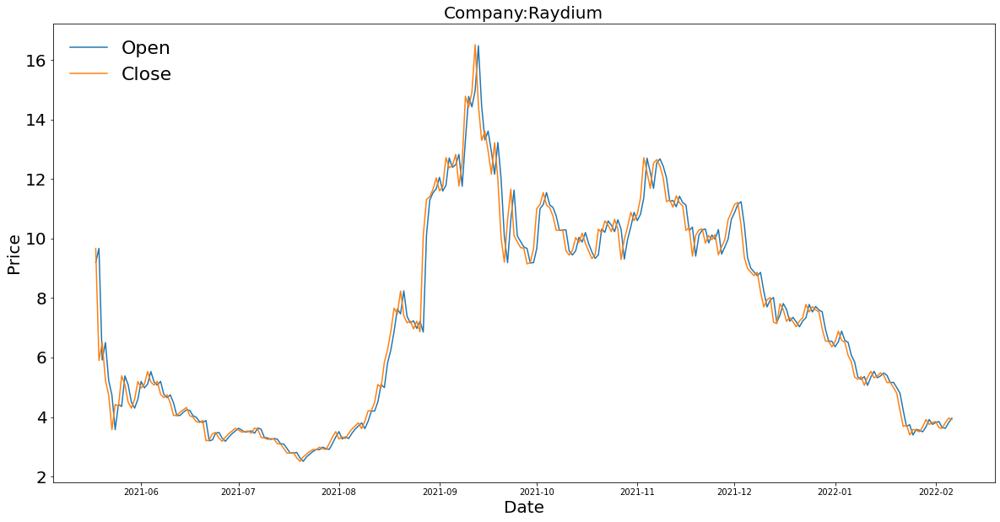

None


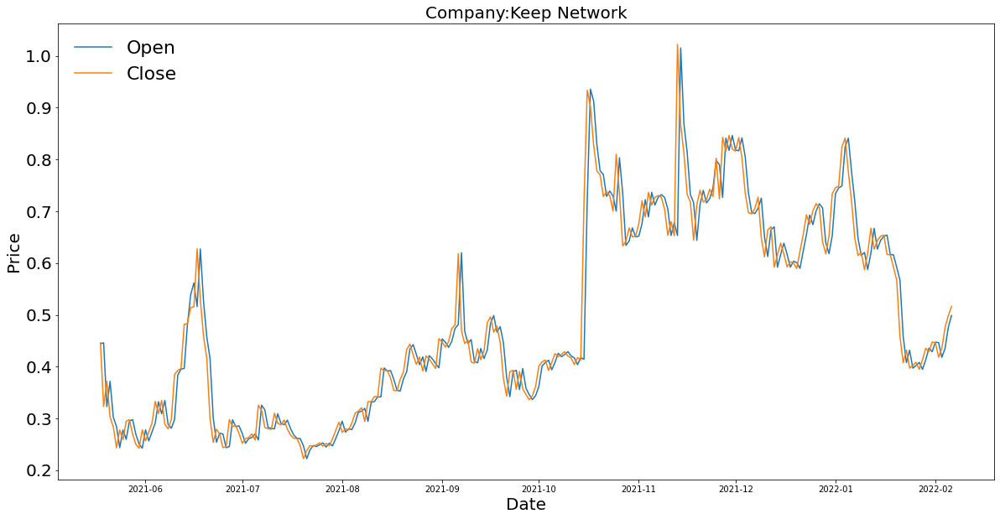

None


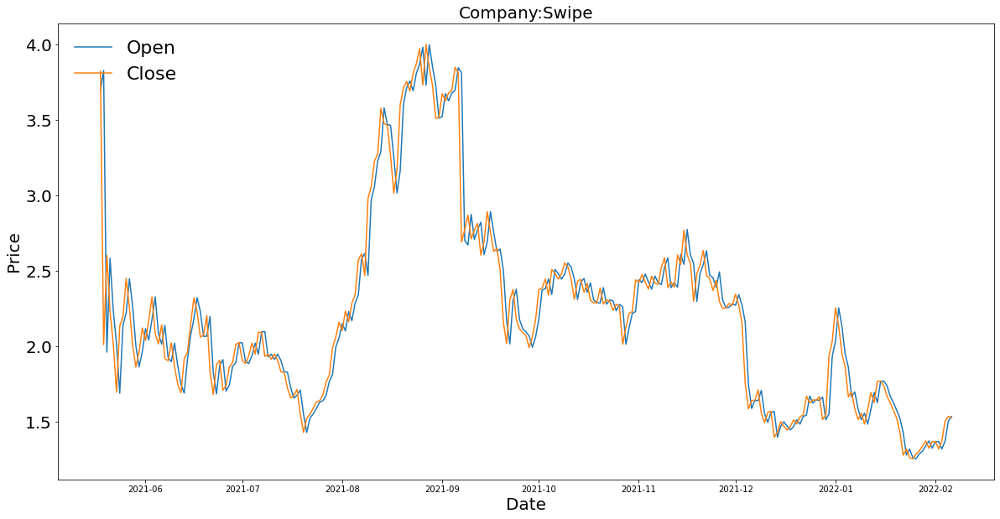

None


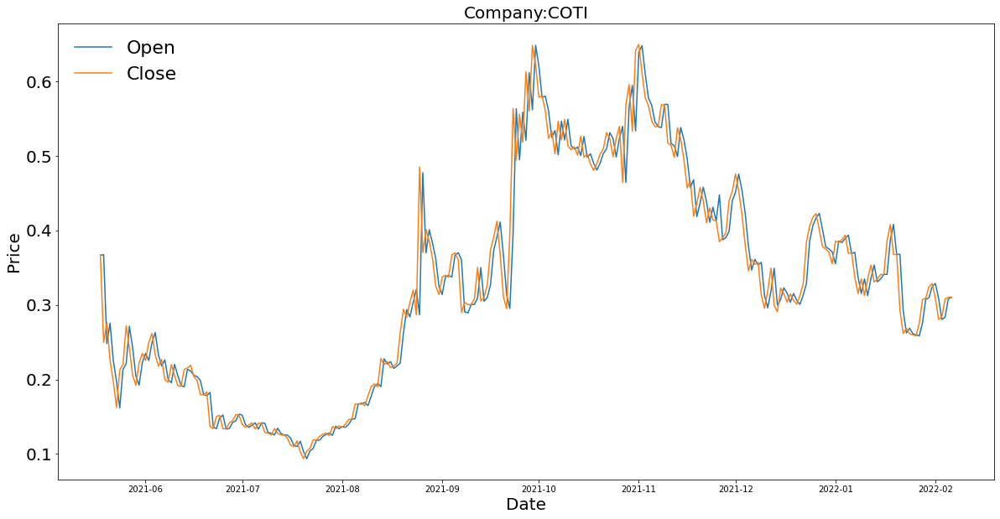

None


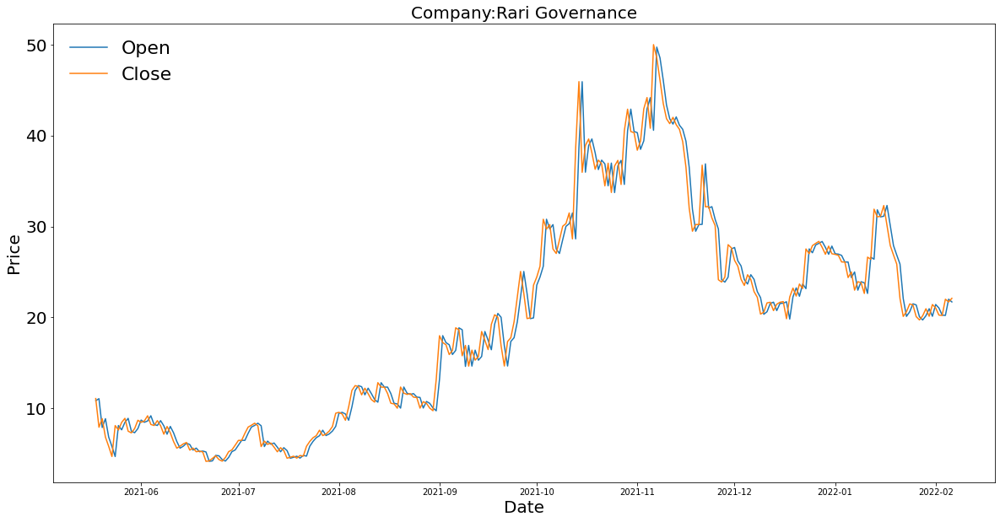

None


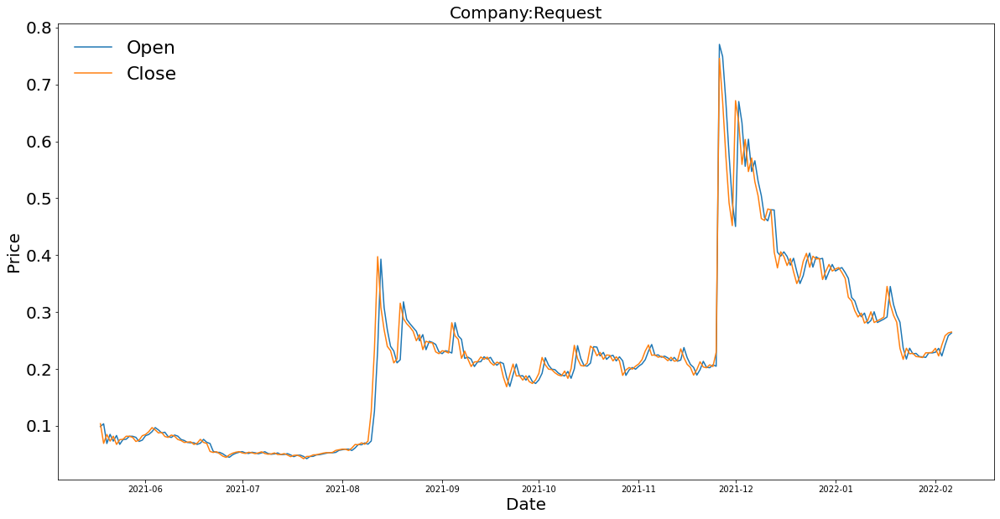

None


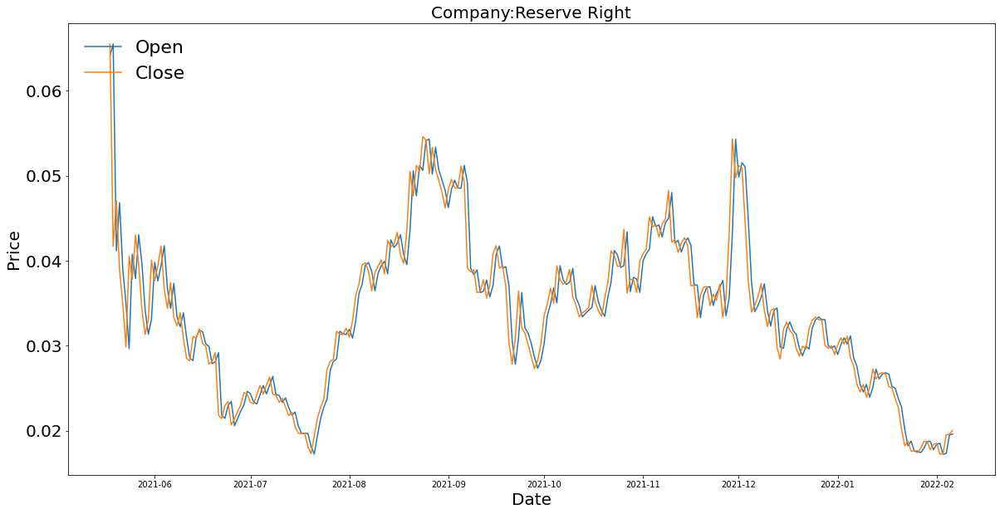

None


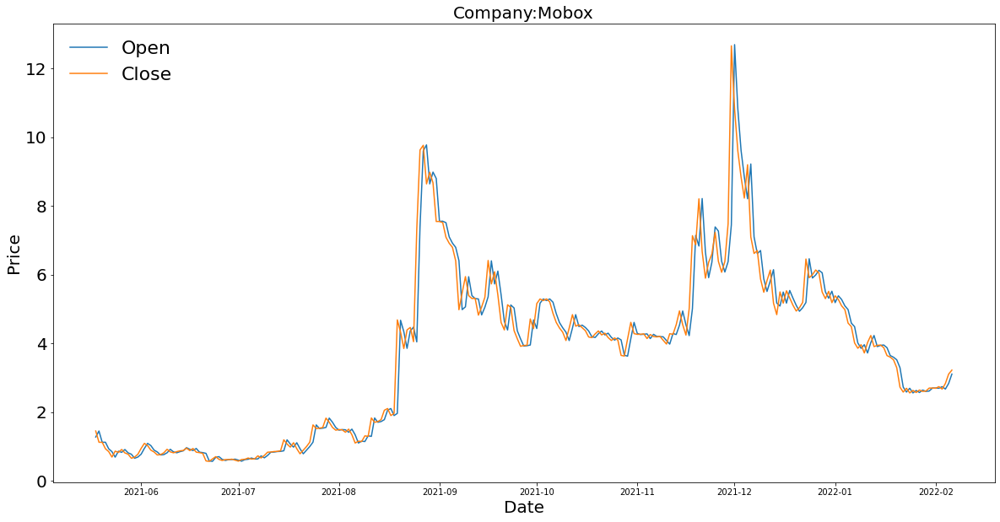

None


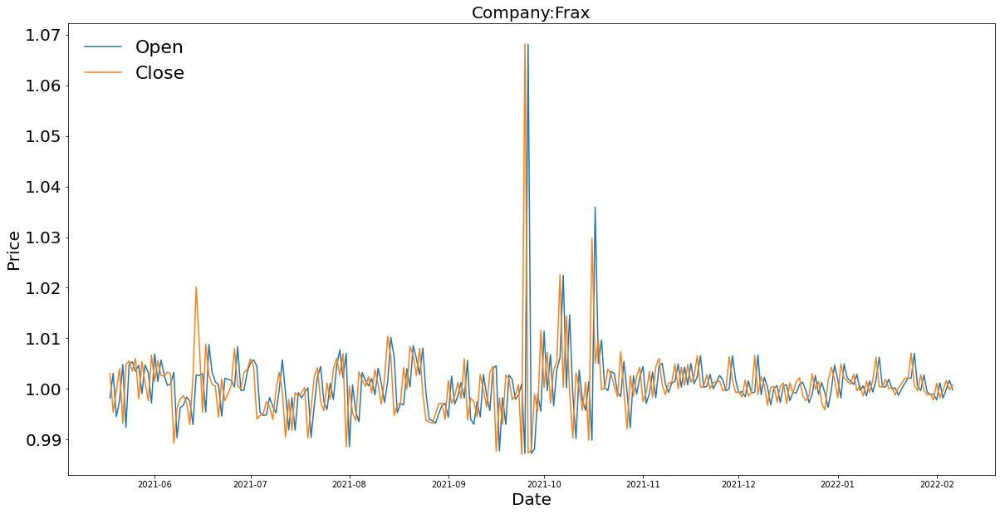

None


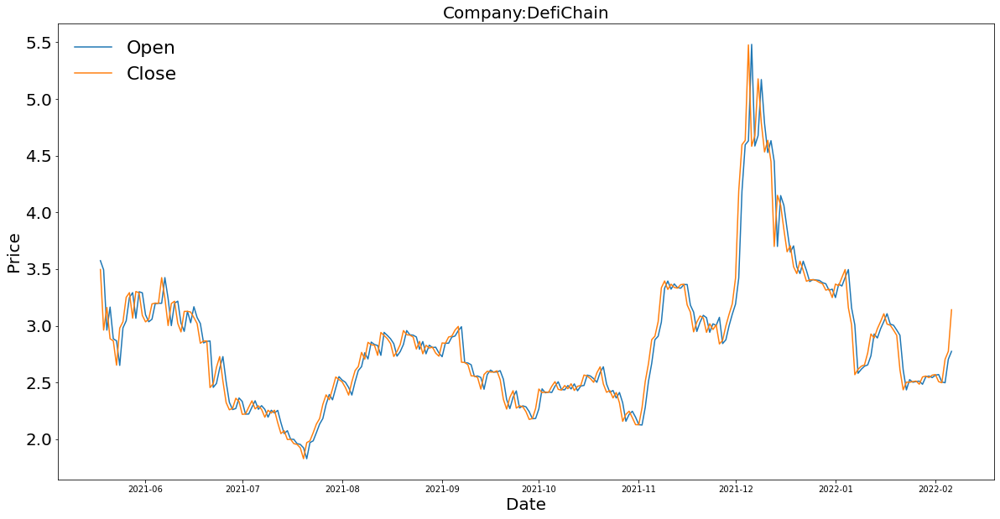

None


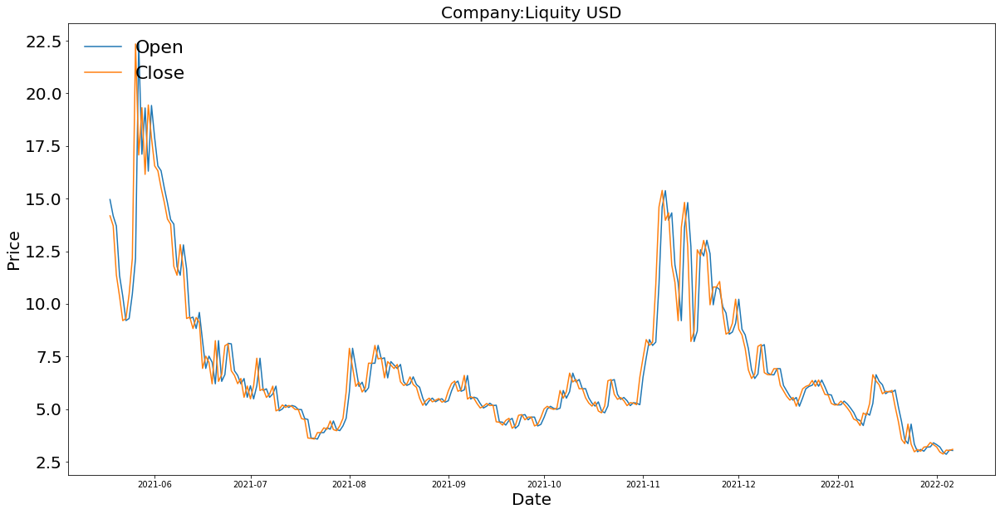

None


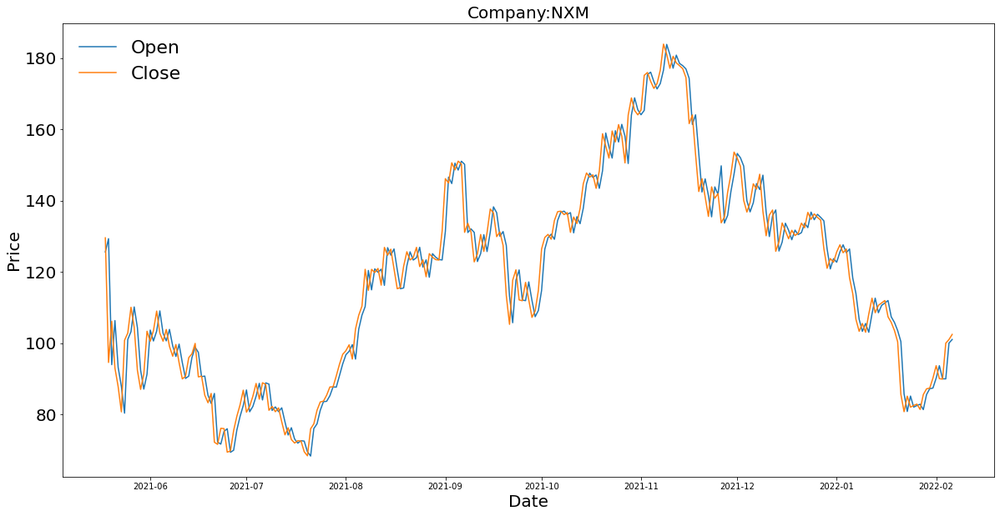

None


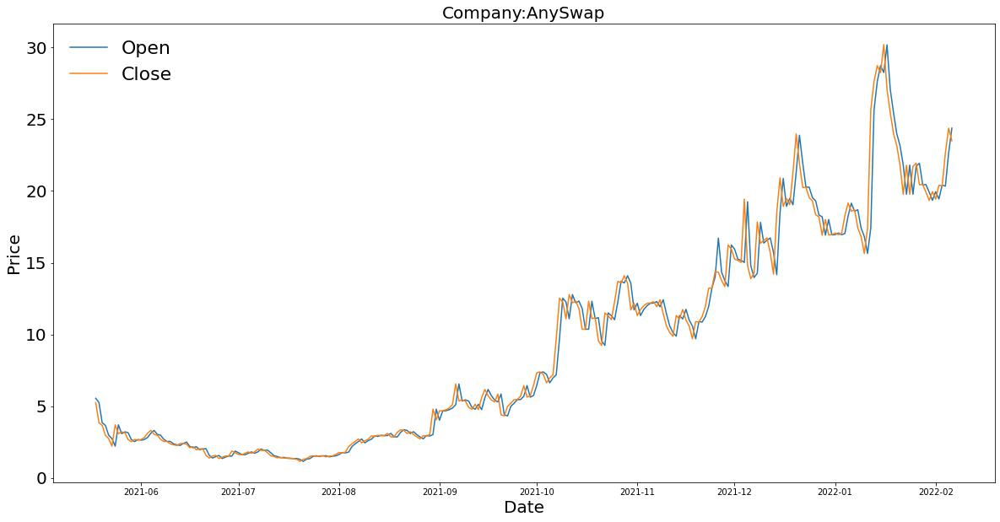

None


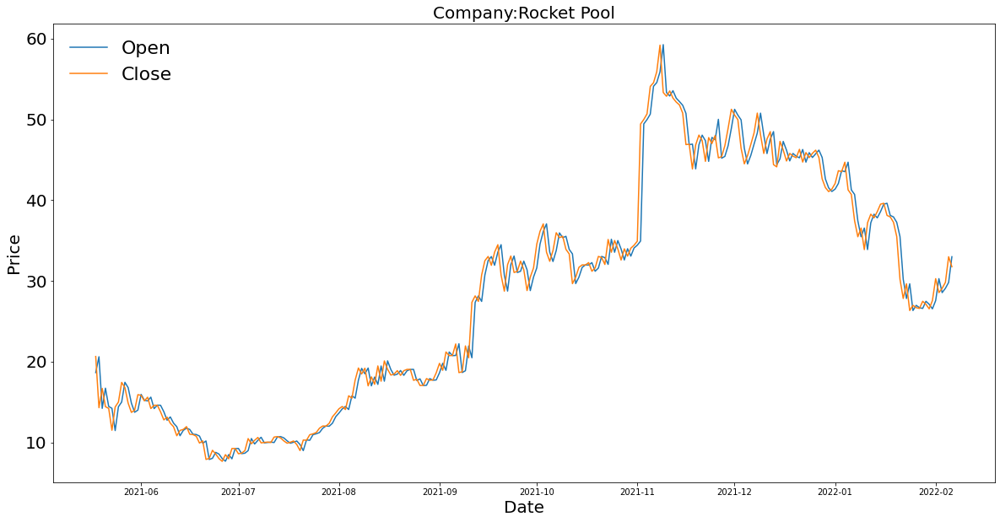

None


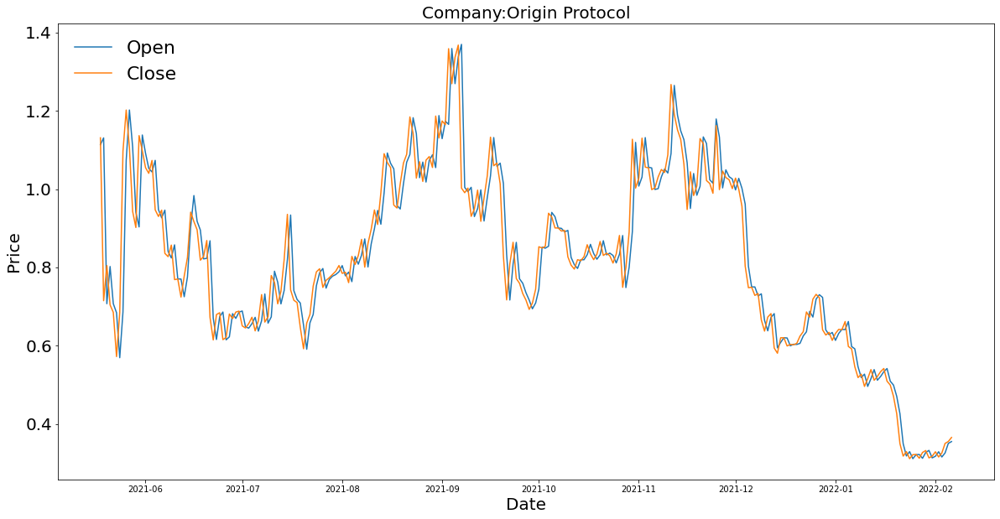

None


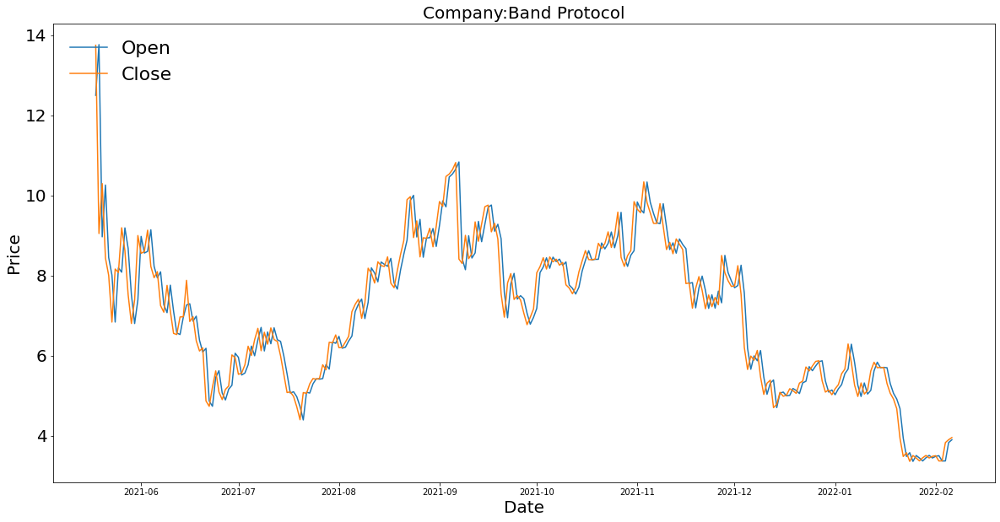

None


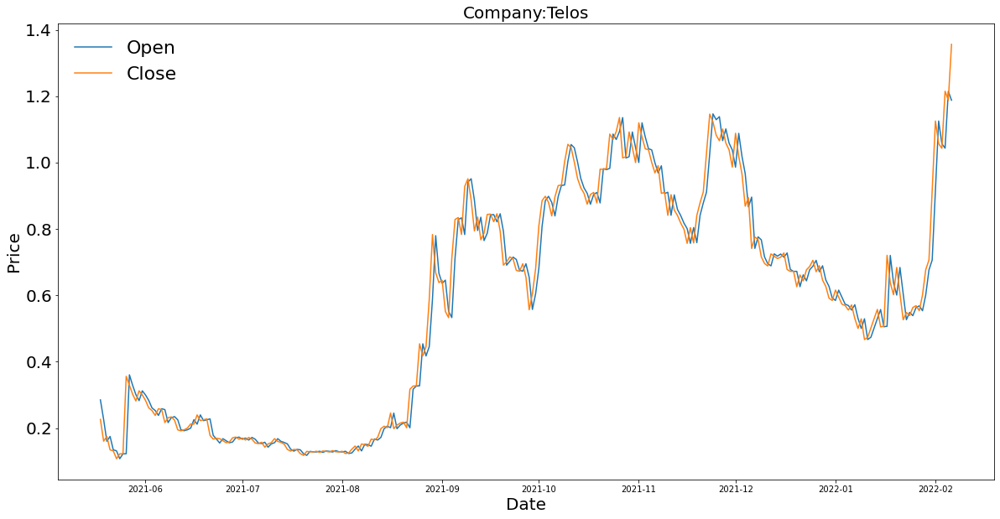

None


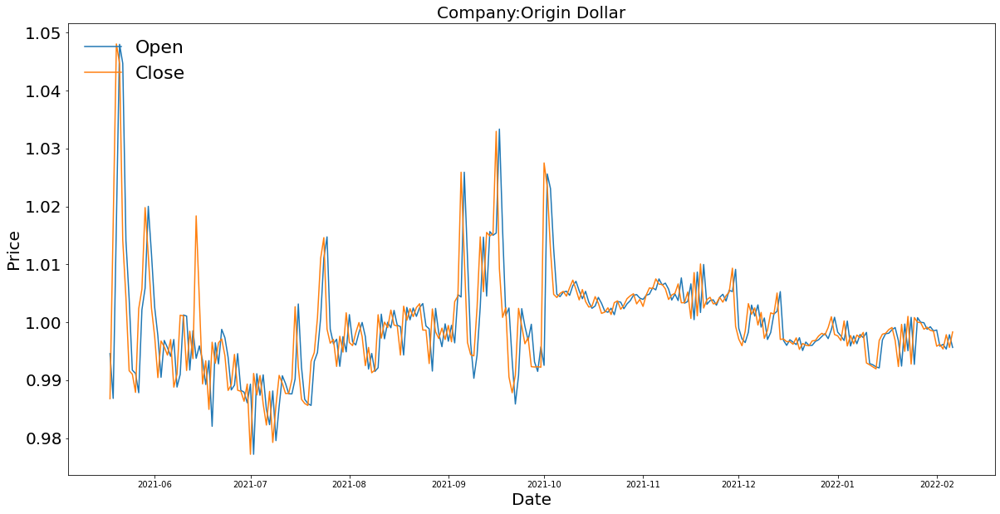

None


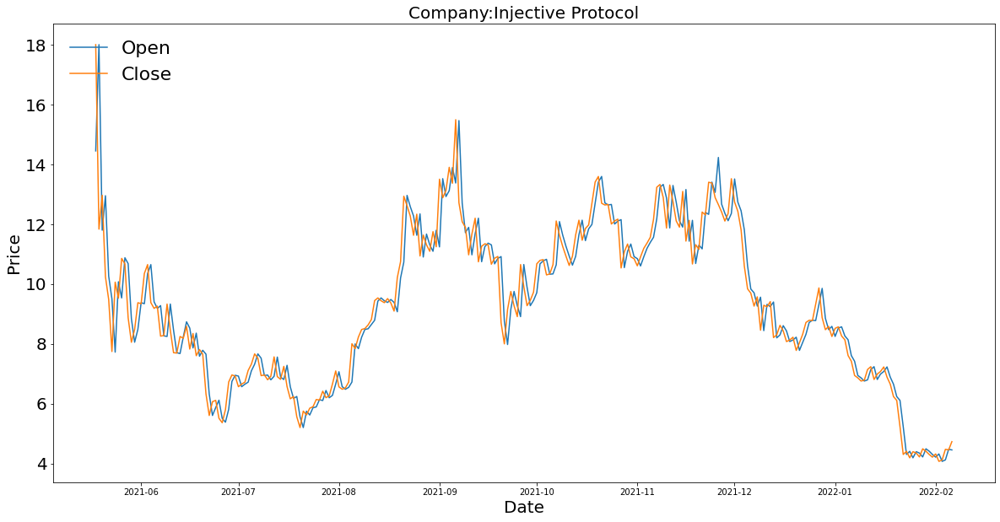

None


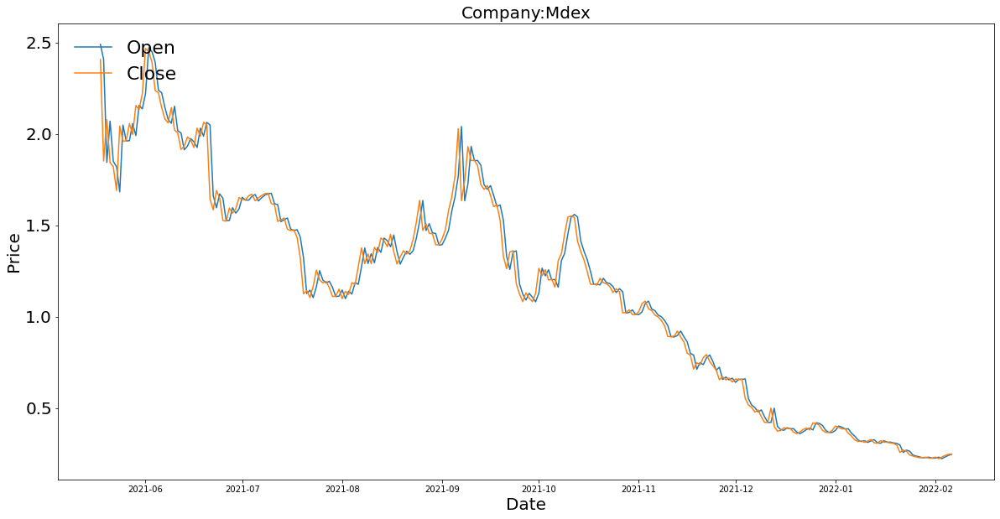

None


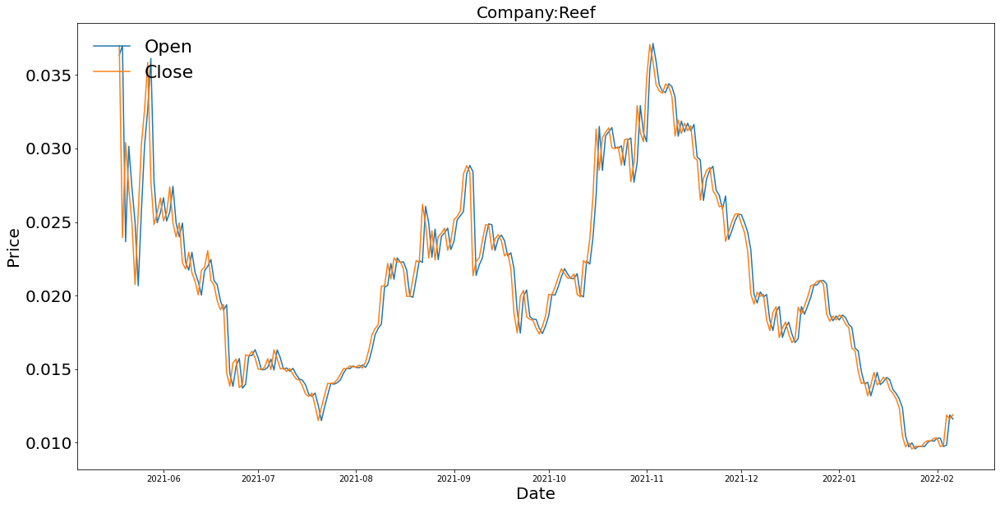

None


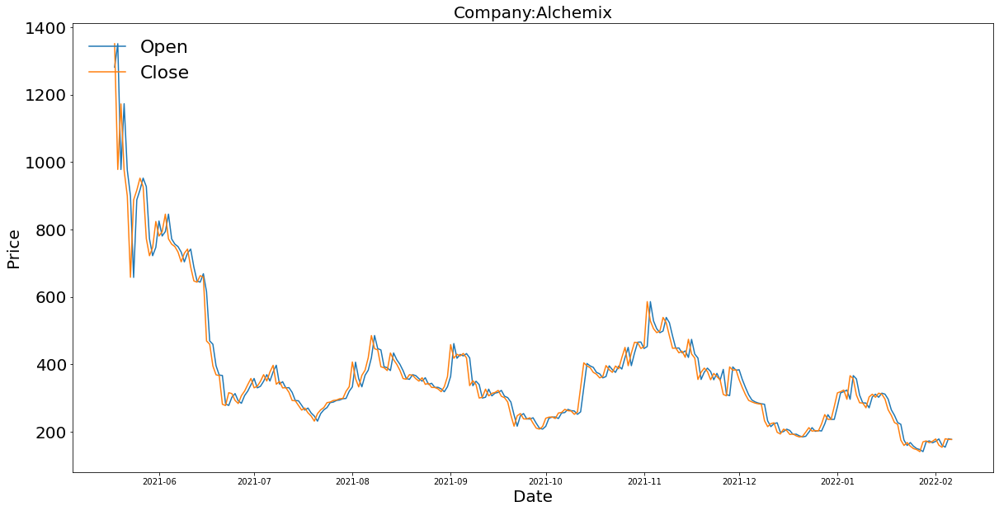

None


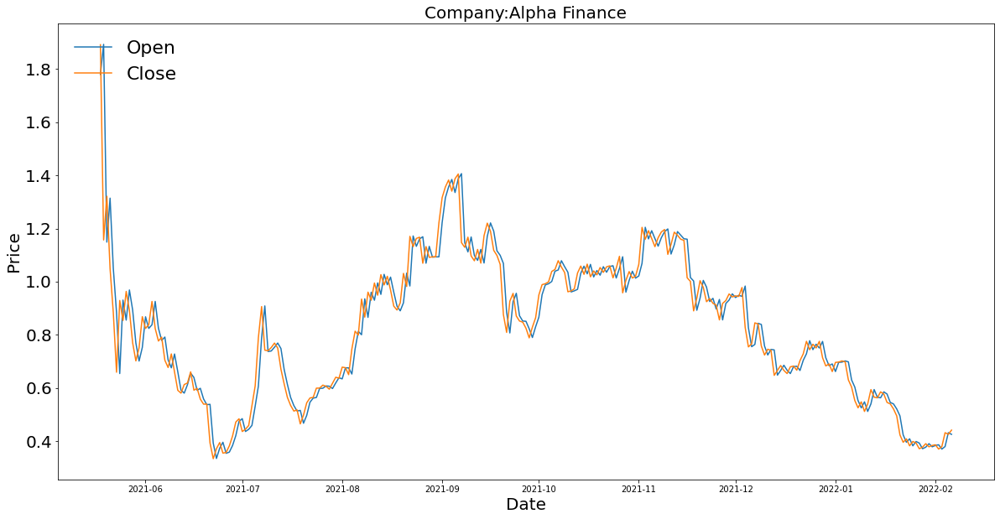

None


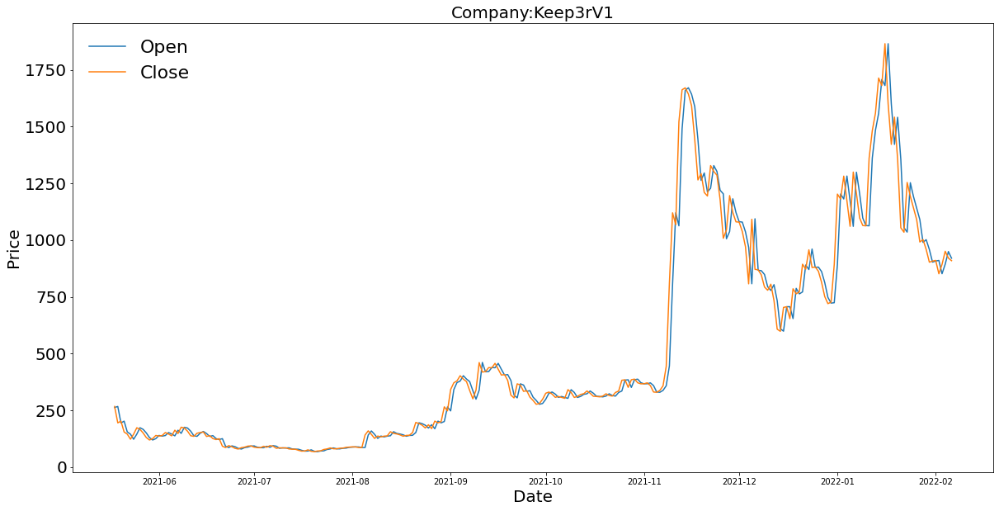

None


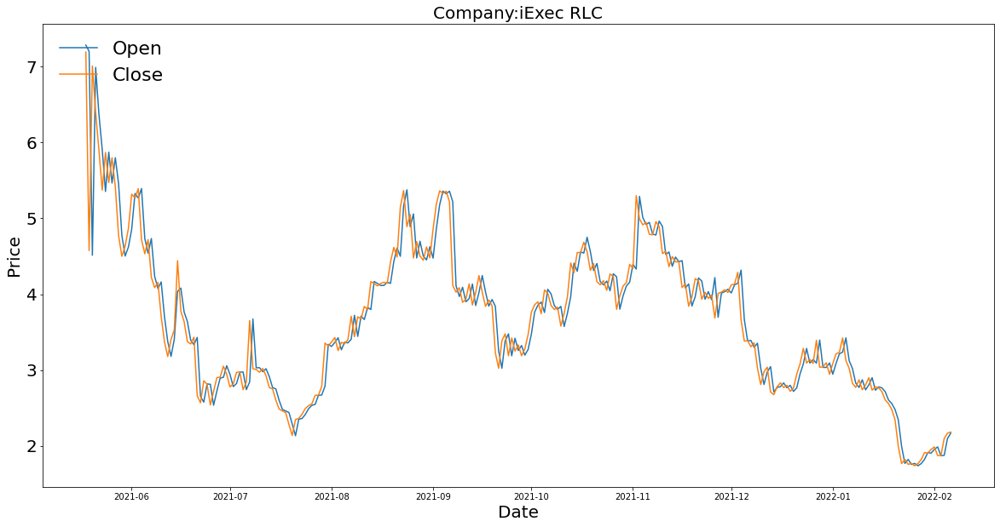

None


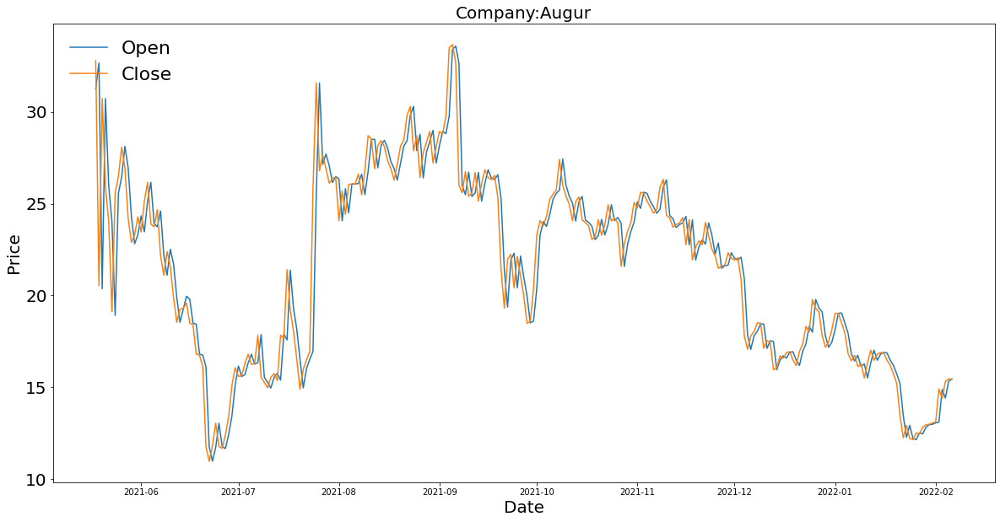

None


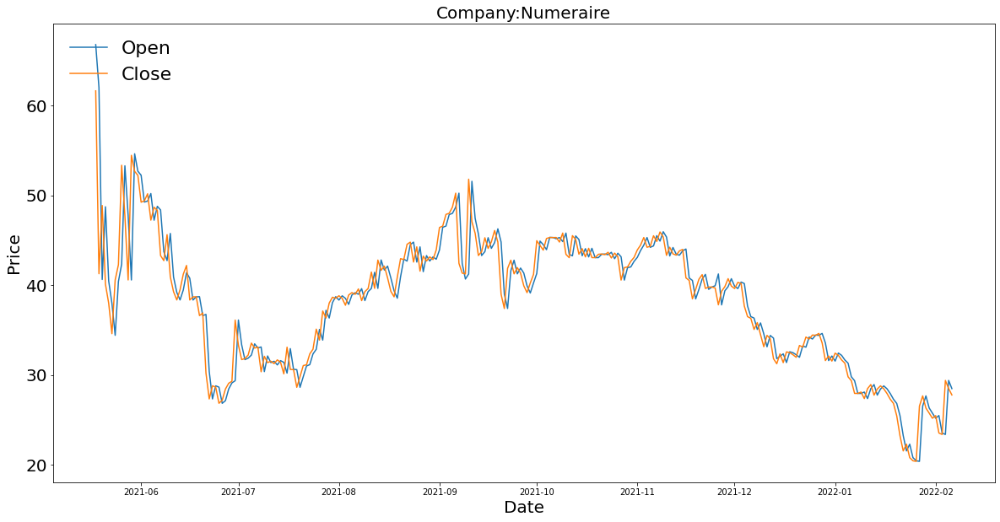

None


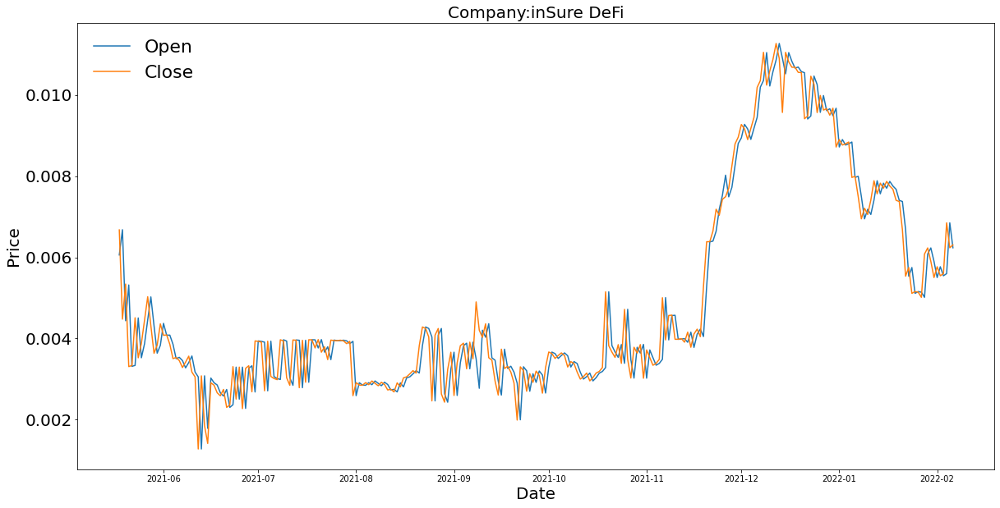

None


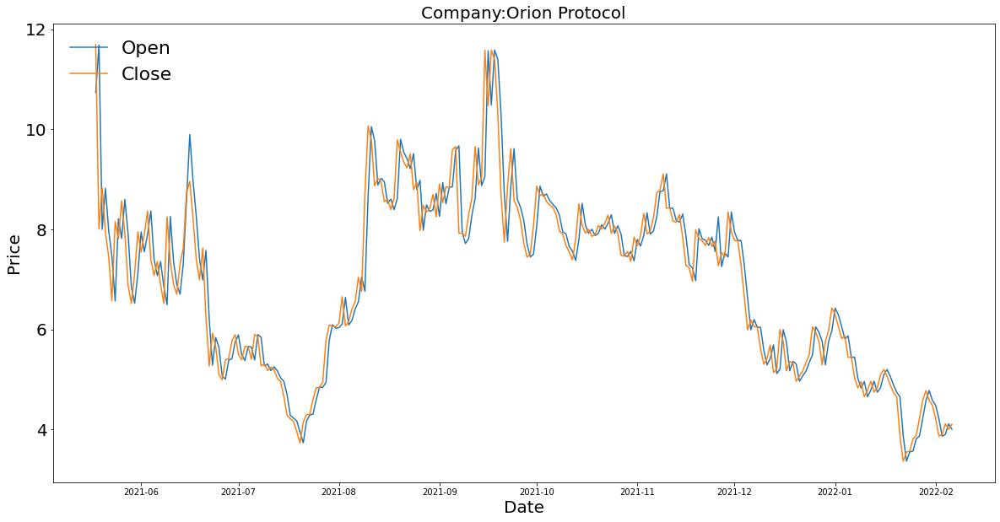

None


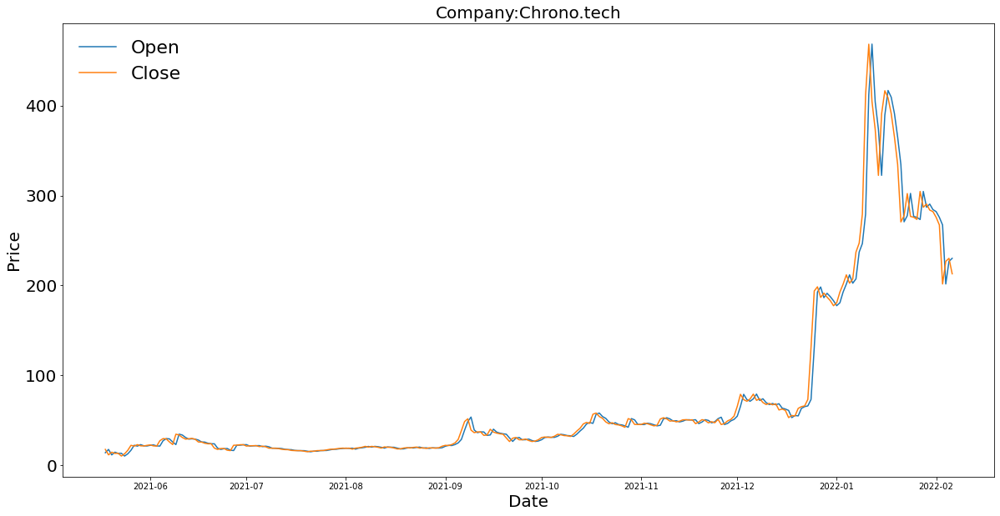

None


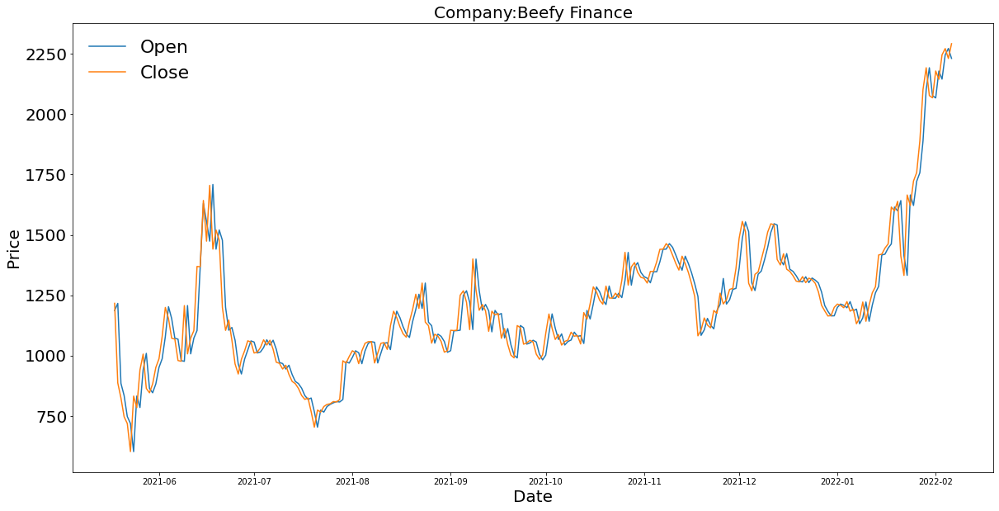

None


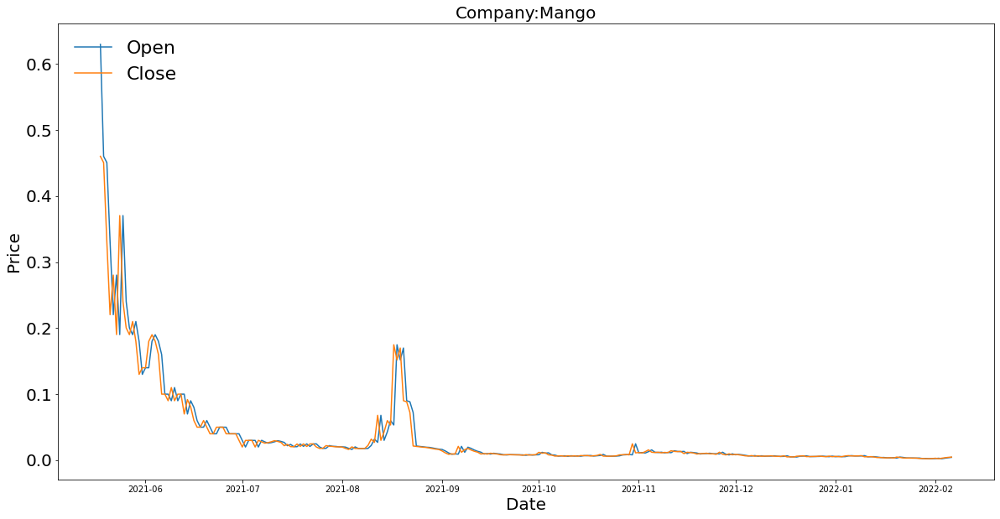

None


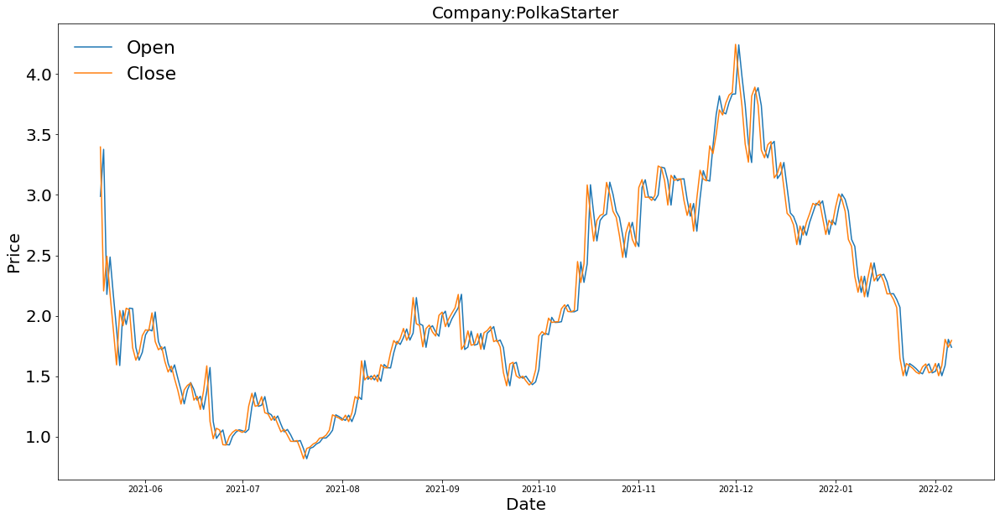

None


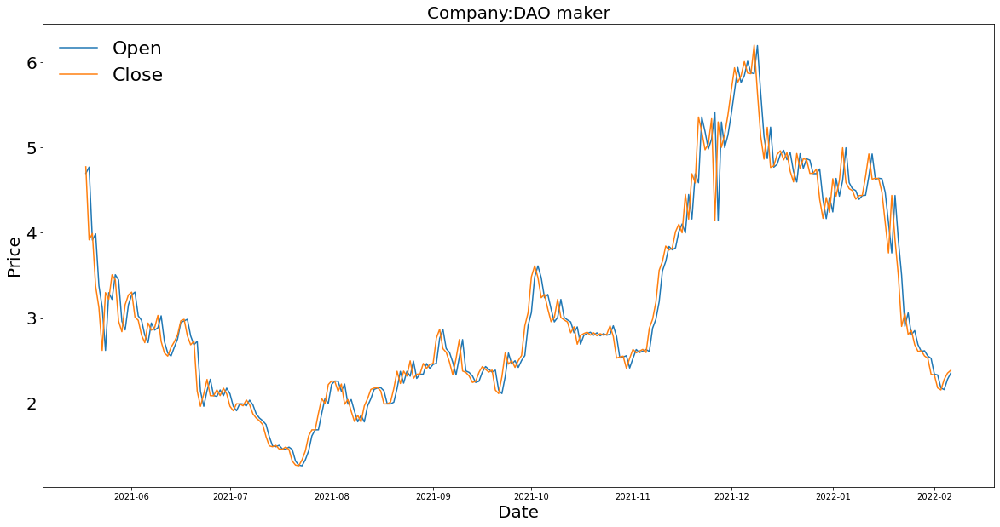

None


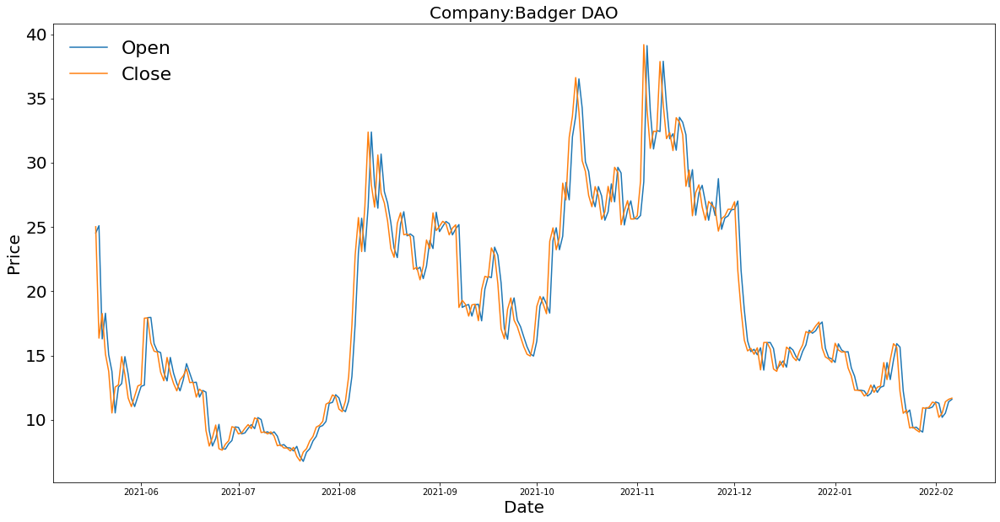

None


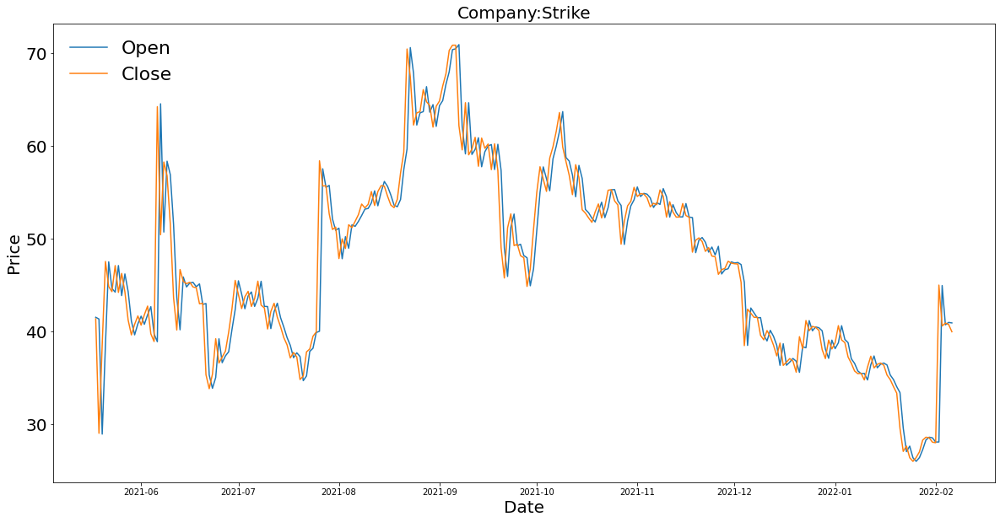

None


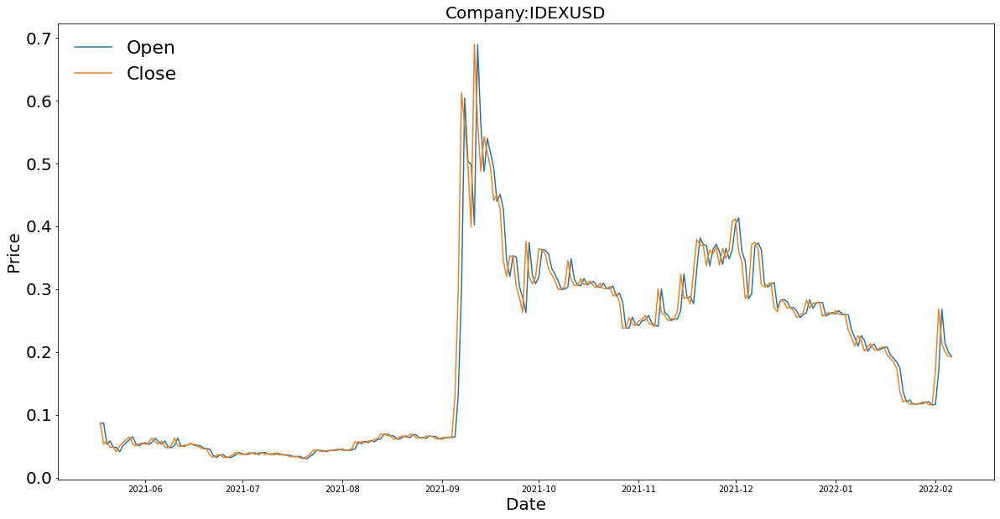

None


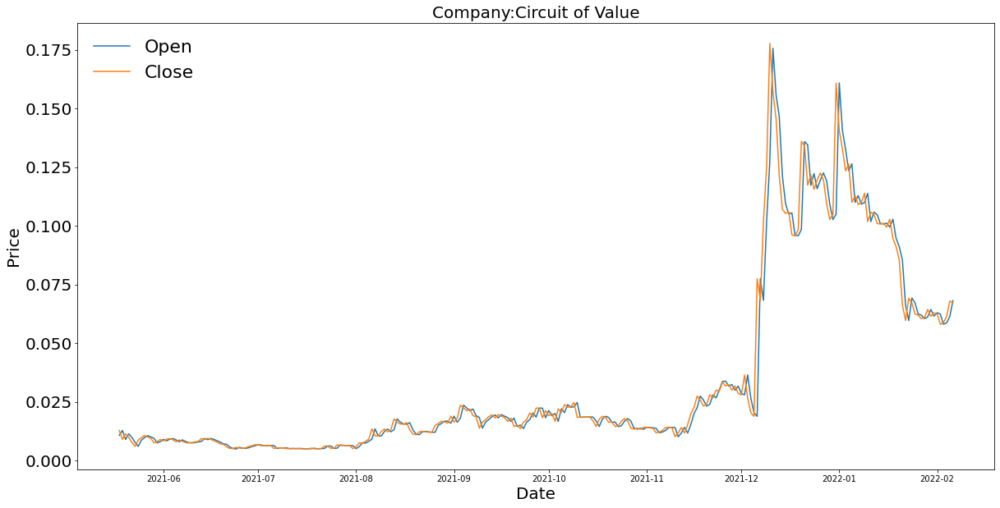

None


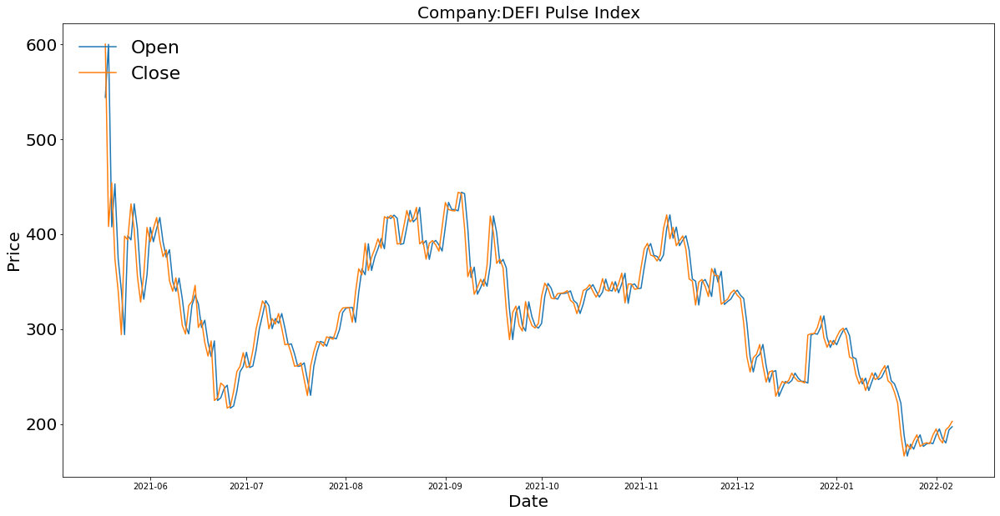

None


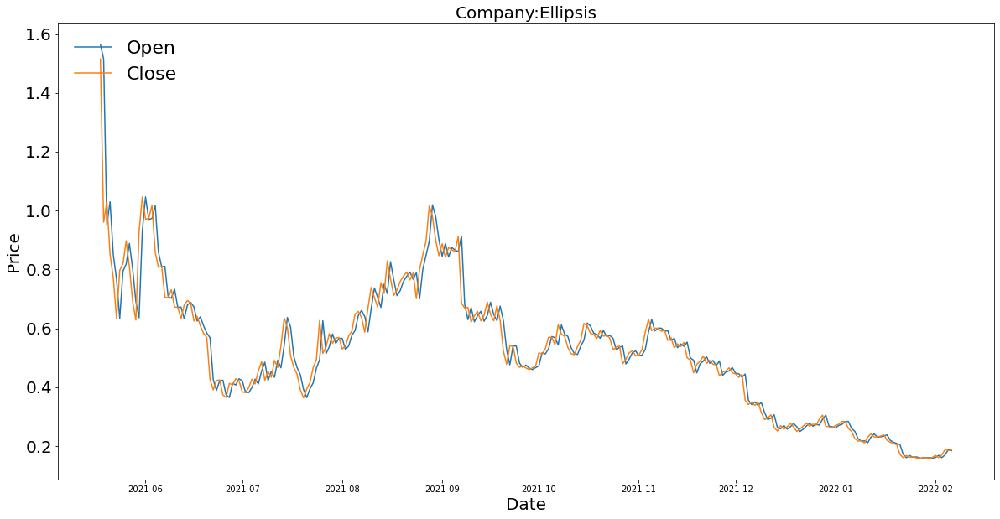

None


In [410]:
# fig, ax2 = plt.subplots(20,4, figsize=(20,100))

keys = list(companies_dict.keys())

for (col,key) in zip(list(df_open.columns[1:]),keys):
    print(open_close_plot(col,key));

### Focusing on the movement trends 

In [411]:
def movements(df = data,title=str(),row=int(),a=int()):
    """
    function to plot individual row trends/movent
    df = data
    title = title of the plot
    row = row index number
    a = starting point
    """
    stock_open = np.array(df['Open']).T # stock_open is numpy array of transpose of df['Open']
    stock_close = np.array(df['Close']).T # stock_close is numpy array of transpose of df['Close']

#‘movement’ is the difference of opening and closing prices of a particular day. Positive movement suggests to go long on stock(buy) and negative movement suggests to short the stock(sell).
    movements = stock_close - stock_open
    plt.figure(figsize = (20,8)) 
    
    # ax1 = plt.subplot(1,2,1)
    plt.title('Company: {}'.format(title),fontsize = 20)
    plt.xticks(fontsize = 18)
    plt.yticks(fontsize = 20)
    plt.xlabel('Date',fontsize = 20)
    plt.ylabel('Movement',fontsize = 20)
    plt.plot(movements[row][a:])    
#     plt.plot(movements[row]) 
    plt.show()

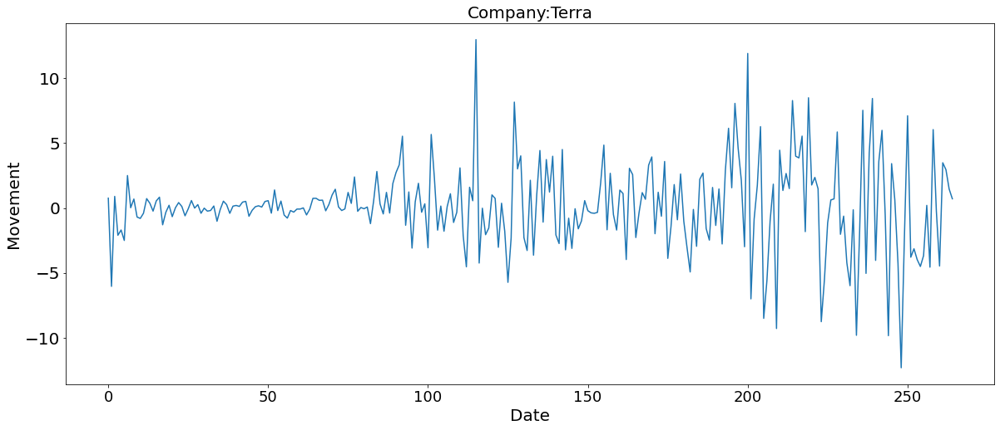

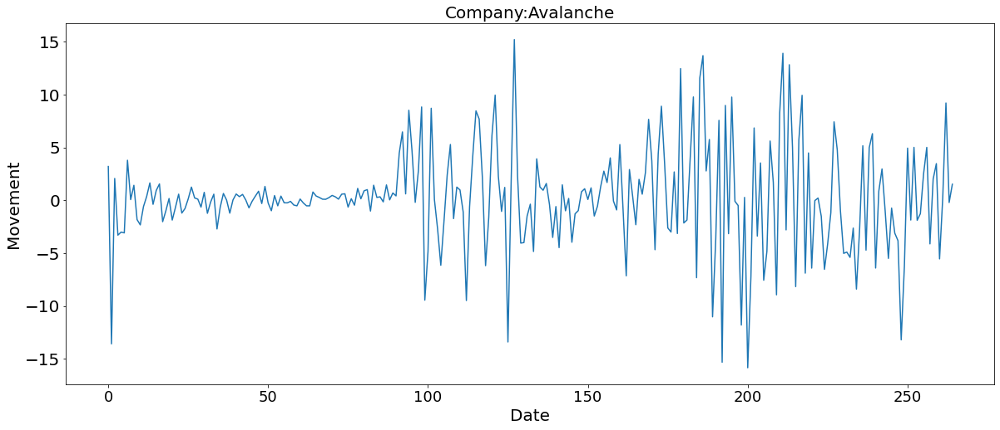

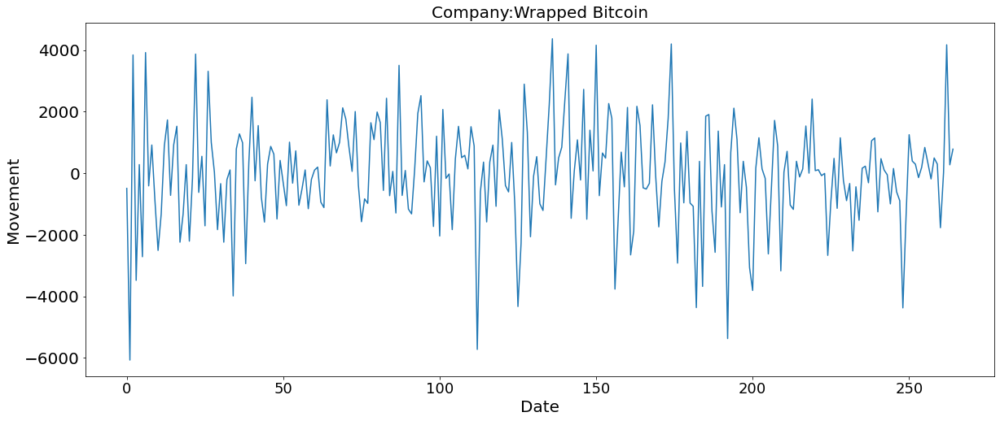

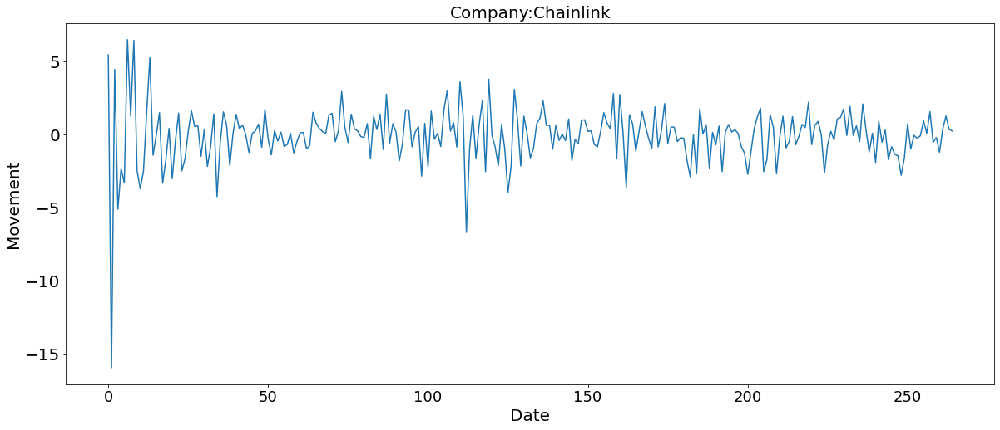

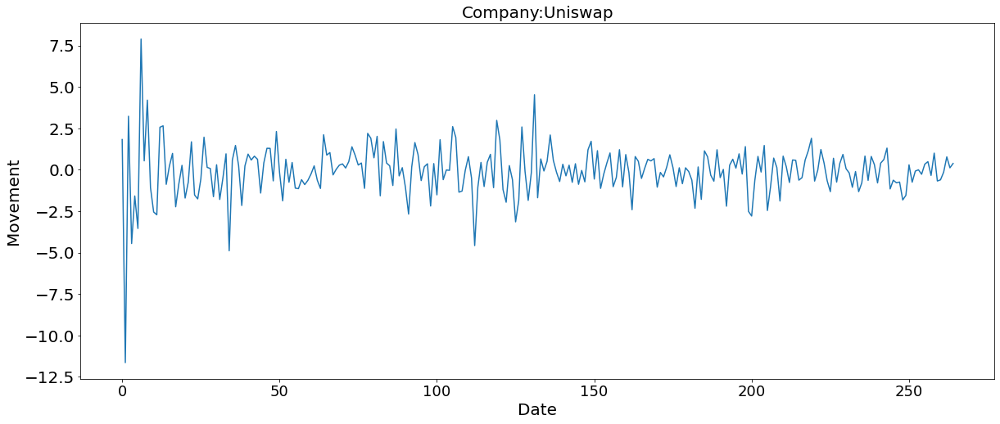

...

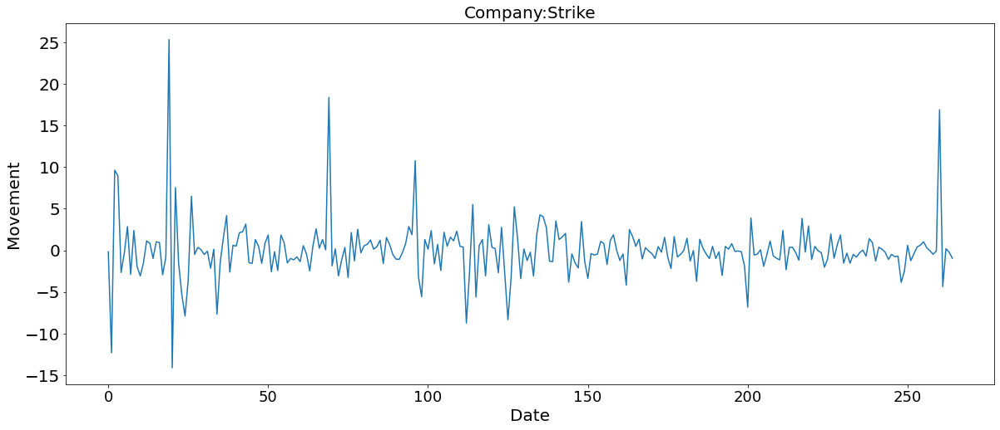

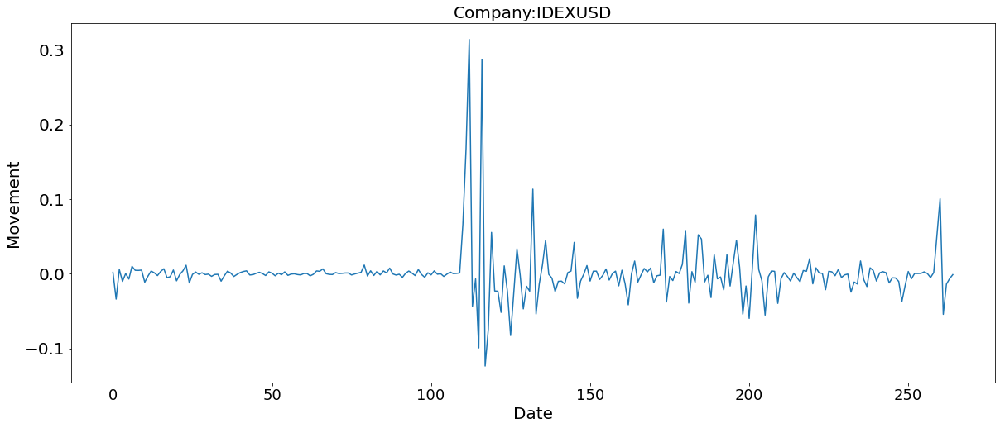

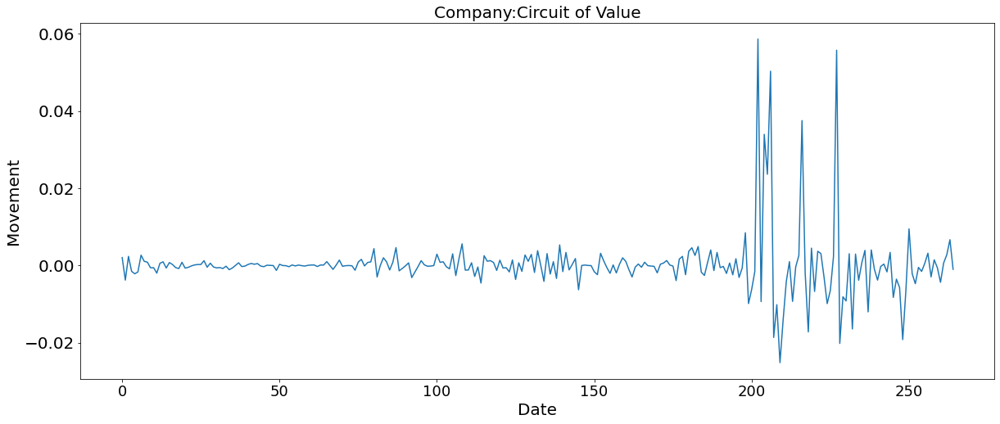

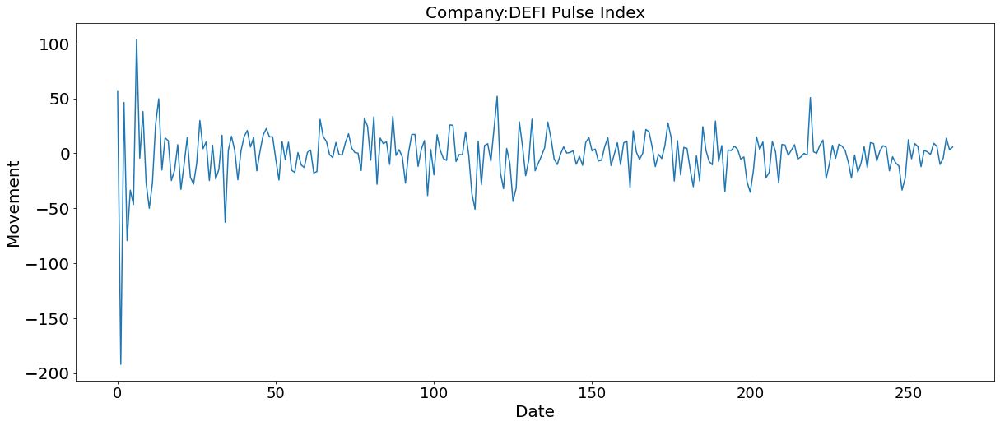

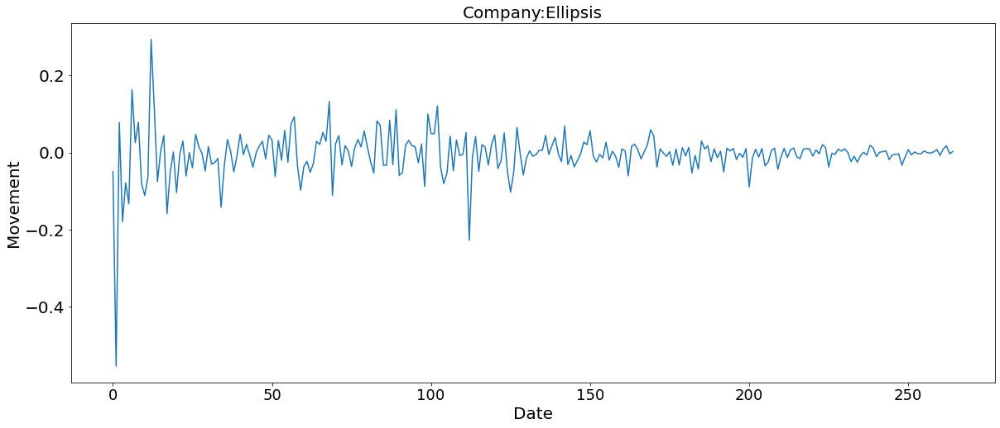

In [412]:
keys = list(companies_dict.keys())

for (key, i) in zip(keys,list(range(len(df_open.columns[1:])))):
    movements(df,key,i,0)

In [ ]:
checking the movement of each company, to understand the velasility of the copies

In [416]:
def volume(df = data,title=str(),row=str()):
    """

    """
    plt.figure(figsize = (20,8)) 
    
    plt.title('Company: {}'.format(title),fontsize = 20)
    plt.xticks(fontsize = 18)
    plt.yticks(fontsize = 20)
    plt.xlabel('Date',fontsize = 20)
    plt.ylabel('Volume',fontsize = 20)
    plt.plot(df['Volume'][row])    
    plt.show()

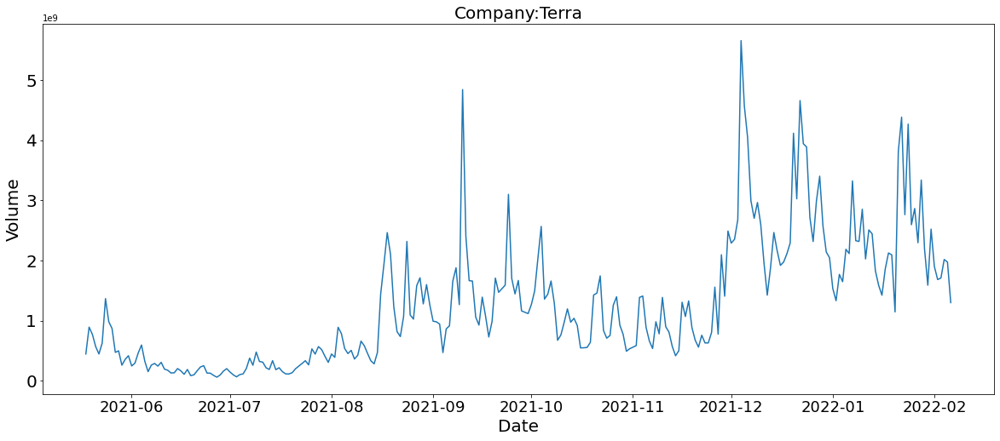

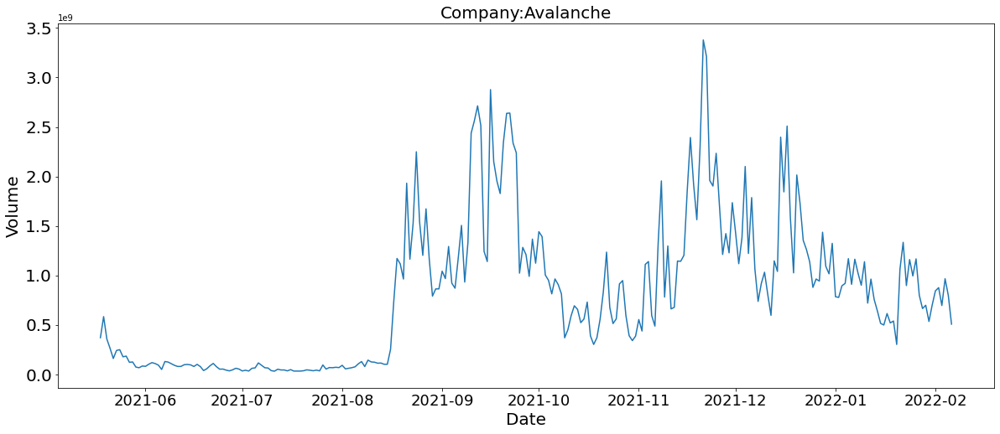

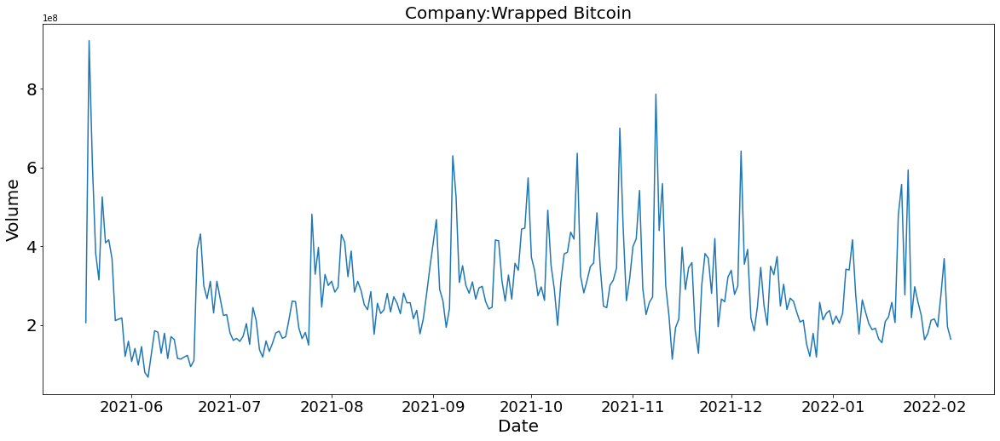

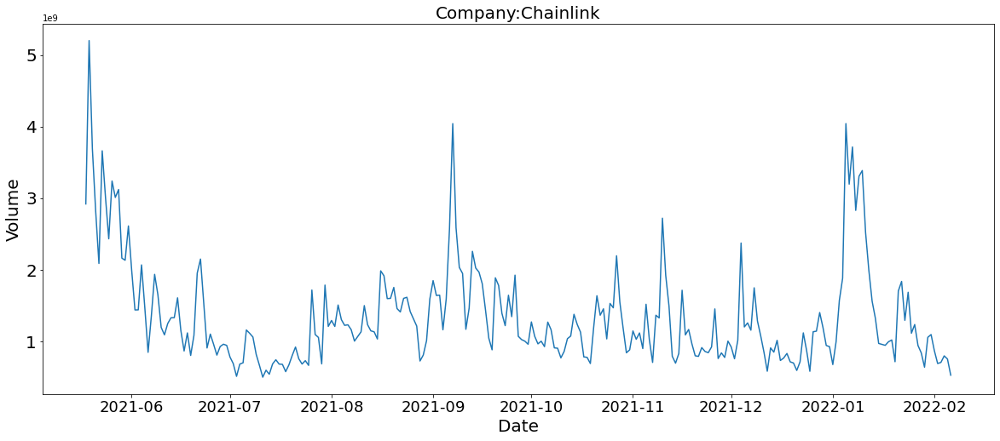

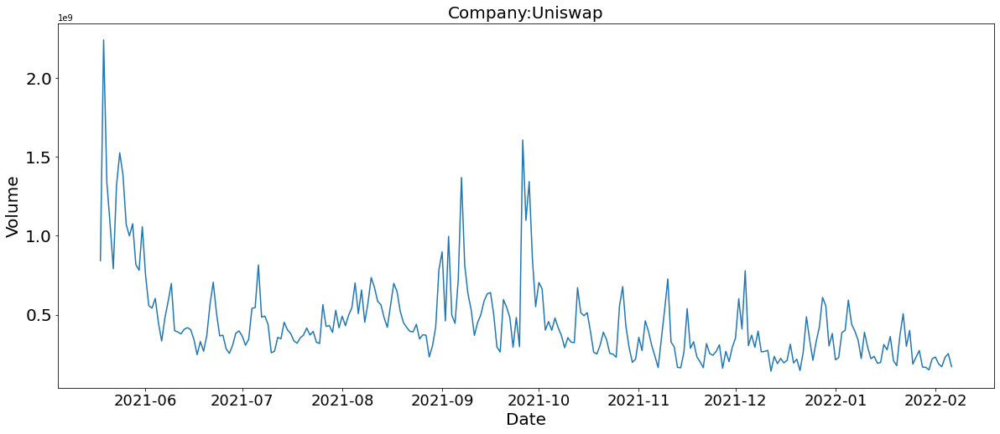

...

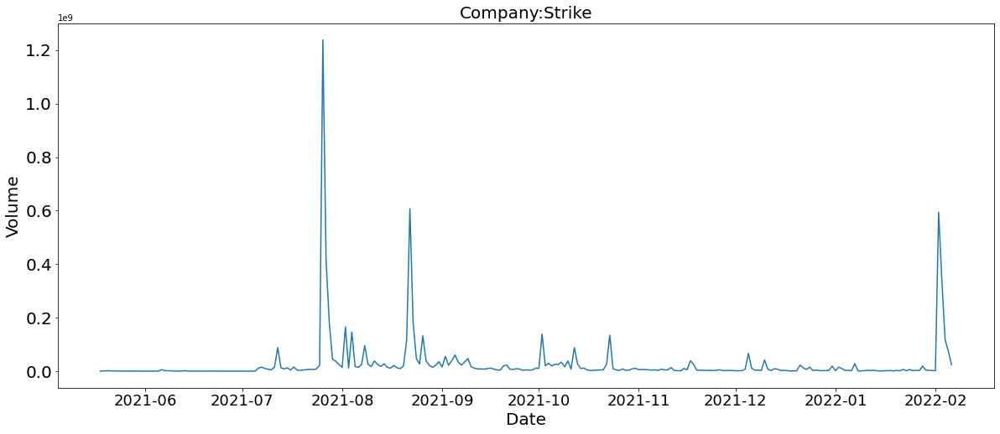

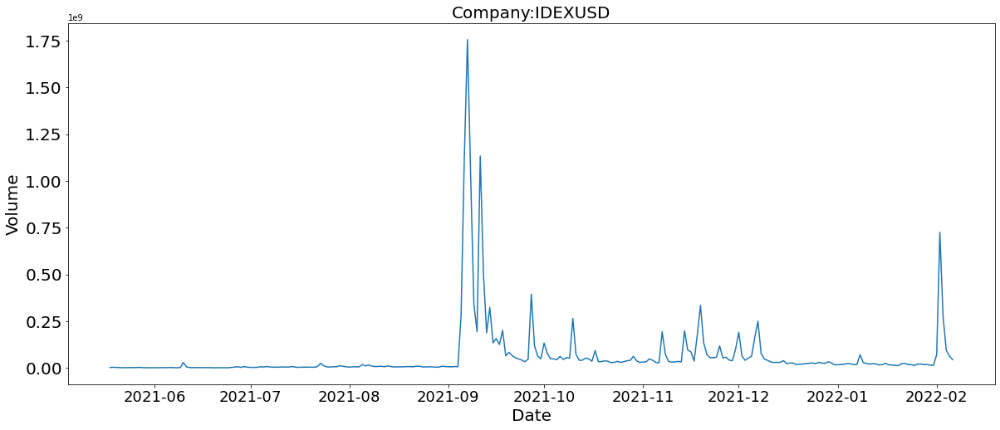

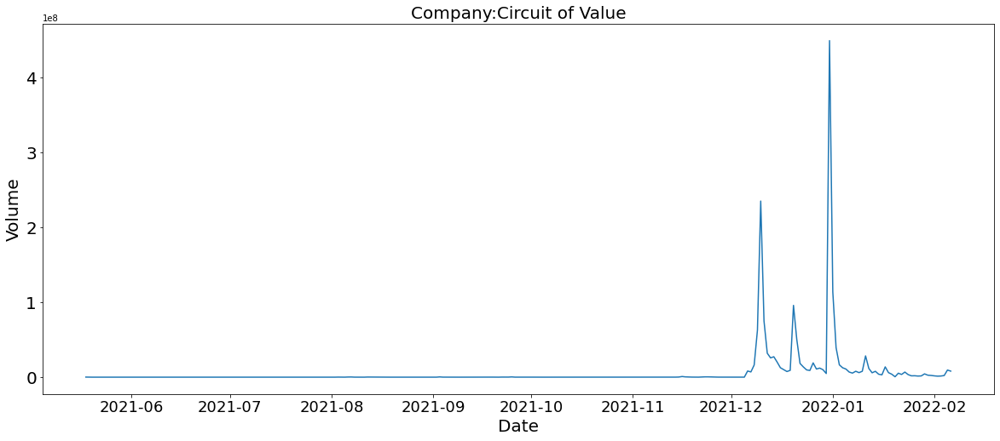

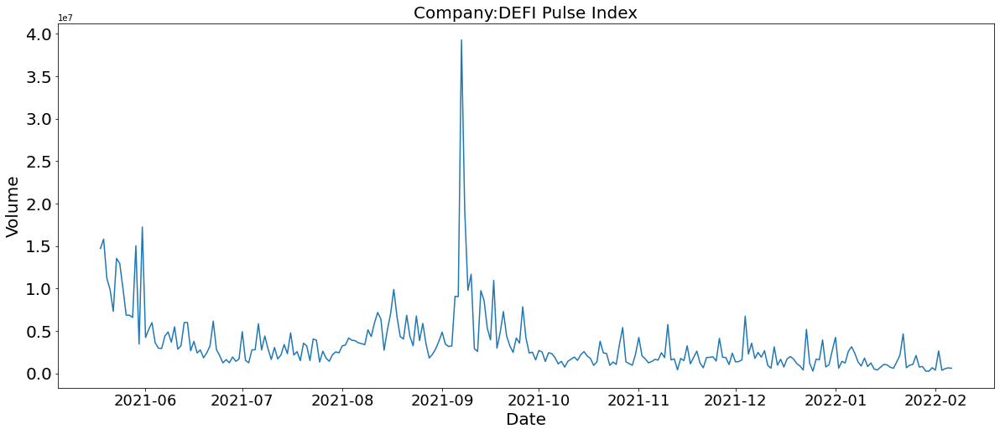

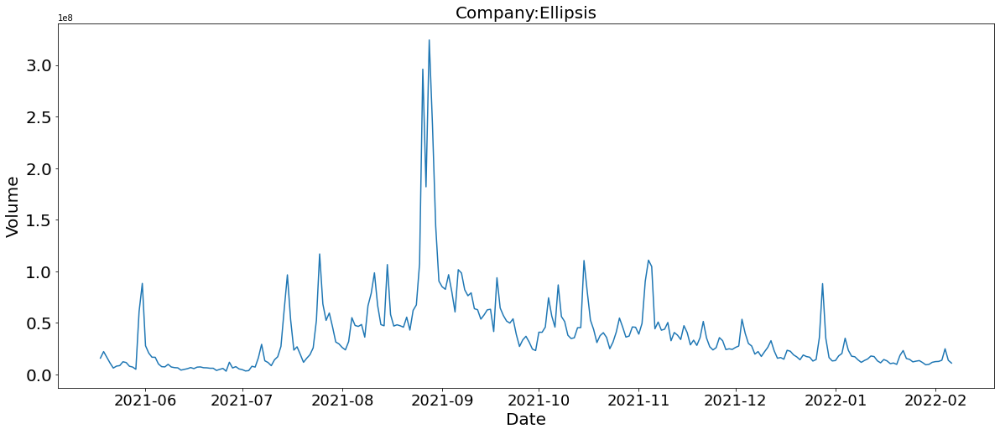

In [418]:
keys = list(companies_dict.keys())
values = list(companies_dict.values())

for (key, value) in zip(keys,values):
    volume(df,key,value)


### Normalization

In [419]:
stock_open = np.array(df['Open']).T # stock_open is numpy array of transpose of df['Open']
stock_close = np.array(df['Close']).T # stock_close is numpy array of transpose of df['Close']

#‘movement’ is the difference of opening and closing prices of a particular day. Positive movement suggests to go long on stock(buy) and negative movement suggests to short the stock(sell).
movements = stock_close - stock_open


from sklearn.preprocessing import Normalizer
normalizer = Normalizer() # Define a Normalizer
norm_movements = normalizer.fit_transform(movements) # Fit and transform

In [420]:
print(norm_movements.min())
print(norm_movements.max())
print(norm_movements.mean())

-0.6050977886778444
0.5394167715570857
-0.0013505646158912307


#### CREATING A PIPELINE

In [421]:
# Import the necessary packages
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import Normalizer
from sklearn.cluster import KMeans
# Define a normalizer
# normalizer = Normalizer()
# # Create Kmeans model
# kmeans = KMeans(n_clusters = 10,max_iter = 1000)
# # Make a pipeline chaining normalizer and kmeans
# pipeline = make_pipeline(normalizer,kmeans)
# # Fit pipeline to daily stock movements
# pipeline.fit(movements)
# predictions = pipeline.predict(movements)

In [375]:
# predictions

In [376]:
# df1 = pd.DataFrame({'labels':predictions,'companies':list(companies_dict)}).sort_values(by=['labels'],axis = 0)

In [377]:
# df1

### Dimension Reduction-Principal Component Analysis(PCA)

In [378]:
# norm_movements.shape #1701 features is a lot 

In [379]:

# from sklearn.decomposition import PCA
# # Define a normalizer
# normalizer = Normalizer()
# # Reduce the data
# reduced_data = PCA(n_components = 2)
# # Create Kmeans model
# kmeans = KMeans(n_clusters = 10,max_iter = 1000)
# # Make a pipeline chaining normalizer, pca and kmeans
# pipeline = make_pipeline(normalizer,reduced_data,kmeans)
# # Fit pipeline to daily stock movements
# pipeline.fit(movements)
# # Prediction
# predictions = pipeline.predict(movements)
# # Create dataframe to store companies and predicted labels
# df2 = pd.DataFrame({'labels':predictions,'companies':list(companies_dict.keys())}).sort_values(by=['labels'],axis = 0)

In [380]:
# df2

### Plot the Decision Boundary

In [473]:
from sklearn.decomposition import PCA


def boundry_plot(df=data,c=10,a=str(),b=str()):
    
    """
    Function to construct a boundry plot
    """
    
    stock_open = np.array(df[a]).T # stock_open is numpy array of transpose of df['Open']
    stock_close = np.array(df[b]).T # stock_close is numpy array of transpose of df['Close']
    #‘movement’ is the difference of opening and closing prices of a particular day. Positive movement suggests to go long on stock(buy) and negative movement suggests to short the stock(sell).
    movements = stock_close - stock_open


    # Define a normalizer
    normalizer = Normalizer()
    # Reduce the data
    reduced_data = PCA(n_components = 2)
    # Create Kmeans model
    kmeans = KMeans(n_clusters = c,max_iter = 1000)
    # Make a pipeline chaining normalizer, pca and kmeans
    pipeline = make_pipeline(normalizer,reduced_data,kmeans)
    # Fit pipeline to daily stock movements
    pipeline.fit(movements)
    # Prediction
    predictions = pipeline.predict(movements)
    # Create dataframe to store companies and predicted labels



    # Reduce the data
    reduced_data = PCA(n_components = 2).fit_transform(norm_movements)
    # Define step size of mesh
    h = 0.01
    # Plot the decision boundary
    x_min,x_max = reduced_data[:,0].min()-1, reduced_data[:,0].max() + 1
    y_min,y_max = reduced_data[:,1].min()-1, reduced_data[:,1].max() + 1
    xx,yy = np.meshgrid(np.arange(x_min,x_max,h),np.arange(y_min,y_max,h))
    # Obtain labels for each point in the mesh using our trained model
    Z = kmeans.predict(np.c_[xx.ravel(),yy.ravel()])
    # Put the result into a color plot
    Z = Z.reshape(xx.shape)
    # Define color plot
    cmap = plt.cm.Paired
    # Plotting figure
    plt.clf()
    plt.figure(figsize=(10,10))
    plt.imshow(Z,interpolation = 'nearest',extent=(xx.min(),xx.max(),yy.min(),yy.max()),cmap = cmap,aspect = 'auto',origin = 'lower')
    plt.plot(reduced_data[:,0],reduced_data[:,1],'k.',markersize = 10)
    # Plot the centroid of each cluster as a white X
    centroids = kmeans.cluster_centers_
    plt.scatter(centroids[:,0],centroids[:,1],marker = 'x',s = 169,linewidths = 3,color = 'w',zorder = 10)
    plt.title('K-Means clustering on stock market movements (PCA-Reduced data)')
    plt.xlim(x_min,x_max)
    plt.ylim(y_min,y_max)
    plt.show()

<Figure size 432x288 with 0 Axes>

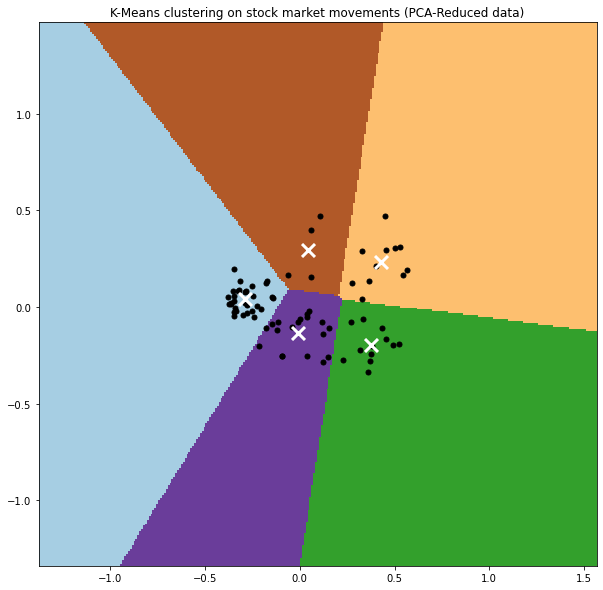

In [474]:
boundry_plot(df,5,a='Open',b='Close')

In [454]:
def pca_df(c=6):
    """
    function to give a tabularized ordered clustering result
    n= n_components
    c= n_clusters
    """
    from sklearn.decomposition import PCA
    # Define a normalizer
    normalizer = Normalizer()
    # Reduce the data
    reduced_data = PCA(n_components = 2)
    # Create Kmeans model
    kmeans = KMeans(n_clusters = c,max_iter = 1000)
    # Make a pipeline chaining normalizer, pca and kmeans
    pipeline = make_pipeline(normalizer,reduced_data,kmeans)
    # Fit pipeline to daily stock movements
    pipeline.fit(movements)
    # Prediction
    predictions = pipeline.predict(movements)
    # Create dataframe to store companies and predicted labels
    df2 = pd.DataFrame({'labels':predictions,'companies':list(companies_dict.keys())}).sort_values(by=['labels'],axis = 0)
    return(df2)

In [456]:
clusters = pca_df(5)
clusters.to_csv('clusters.csv',index=False)
clusters

,labels,companies
77,0,Ellipsis
33,0,UMA USD
76,0,DEFI Pulse Index
40,0,Swipe
29,0,Bakery Token
...,...,...
25,4,Kava
49,4,NXM
47,4,DefiChain
2,4,Wrapped Bitcoin


In [467]:
def check_cluster(df= data, i=int()):
    """
    A function to allow you check the various clusters you have derived
    """
    return(df[df['labels']==i])

In [469]:
check_cluster(clusters,1)

,labels,companies
50,1,AnySwap
42,1,Rari Governance
61,1,Keep3rV1
37,1,Frax Share
0,1,Terra
16,1,Oasis Network
1,1,Avalanche
5,1,Fantom
13,1,Convex Finance
15,1,Loopring


In [470]:
norm_movements.shape

(78, 265)